<a href="https://colab.research.google.com/github/jremsza/computer-vision_brain-scans/blob/main/mri-brain-scan-project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img src="https://github.com/djp840/MSDS_458_Public/blob/main/images2/NorthwesternHeader.png?raw=1" />

## MSDS458 Final Research Assignment

### Analyze Brain MRI Data <br>

The Brain Tumor dataset is a collection of 7023 MRI brain imigining scans.<br>

For more information, please refer to the link https://www.kaggle.com/datasets/rm1000/brain-tumor-mri-scans <br>


The Brain Scans classification dataset is constructed with 4 classes (**Healthy**, **Glioma**, **Meningioma**, and **Pituitary**). Each class contains a different number of samples. <br>

Homepage: https://arxiv.org/abs/1509.01626<br>

1.0.0 (default): No release notes.<br>
License: CC0-1.0<br>
Download size: 261.98 MB

### Imports

In [ ]:
import cv2
import os

import numpy as np
import pandas as pd
import datetime
import time
from collections import Counter
from packaging import version

from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import mean_squared_error as MSE
from sklearn.model_selection import train_test_split
from sklearn.manifold import TSNE

import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import models, Model, layers, Input, regularizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Conv2D, MaxPool2D, BatchNormalization, Dropout, Flatten, Dense
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.preprocessing import image
import tensorflow.keras.backend as k
from tensorflow.keras.regularizers import l2
from transformers import TFViTForImageClassification, ViTFeatureExtractor, TFViTModel
from keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.applications import ResNet50

In [ ]:
%matplotlib inline
np.set_printoptions(precision=3, suppress=True)

### Verify TensorFlow Version

In [ ]:
print('Found TensorFlow', tf.__version__)
assert version.parse(tf.__version__).release[0] >= 2, \
    'This notebook requires TensorFlow 2.0 or above'

Found TensorFlow 2.17.1


### Mount Google Drive to Colab Env

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Reporting Functions

In [ ]:
def plot_history(history):
  losses = history.history['loss']
  accs = history.history['accuracy']
  val_losses = history.history['val_loss']
  val_accs = history.history['val_accuracy']
  epochs = len(losses)

  plt.figure(figsize=(16, 4))
  for i, metrics in enumerate(zip([losses, accs], [val_losses, val_accs], ['Loss', 'Accuracy'])):
    plt.subplot(1, 2, i + 1)
    plt.plot(range(epochs), metrics[0], label='Training {}'.format(metrics[2]))
    plt.plot(range(epochs), metrics[1], label='Validation {}'.format(metrics[2]))
    plt.legend()
  plt.show()

def display_training_curves(training, validation, title, subplot):
  ax = plt.subplot(subplot)
  ax.plot(training)
  ax.plot(validation)
  ax.set_title('model '+ title)
  ax.set_ylabel(title)
  ax.set_xlabel('epoch')
  ax.legend(['training', 'validation'])

### Validation Report Function

In [ ]:
def print_validation_report(y_test, predictions):
    print("Classification Report")
    print(classification_report(y_test, predictions))
    print('Accuracy Score: {}'.format(accuracy_score(y_test, predictions)))
    print('Root Mean Square Error: {}'.format(np.sqrt(MSE(y_test, predictions))))

### Confusion Matrix

In [ ]:
def plot_confusion_matrix(y_true, y_pred):
    mtx = confusion_matrix(y_true, y_pred)
    fig, ax = plt.subplots(figsize=(16,12))
    sns.heatmap(mtx, annot=True, fmt='d', linewidths=.75,  cbar=False, ax=ax,cmap='Blues',linecolor='white')
    #  square=True,
    plt.ylabel('true label')
    plt.xlabel('predicted label')

## Import the Kaggle File with API Key

In [ ]:
from google.colab import files
files.upload()

### Make directory to store the dataset

In [ ]:
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

### Download the dataset from URL & Unzip

In [ ]:
download_path = '/content/drive/MyDrive/DS-458/assignment 4'
dataset_name = 'brain-tumor-mri-scans'
zip_file_path = os.path.join(download_path, dataset_name + '.zip')
unzip_path = os.path.join(download_path, dataset_name)

# Create directories
os.makedirs(download_path, exist_ok=True)
os.makedirs(unzip_path, exist_ok=True)

In [ ]:
!kaggle datasets download -d "rm1000/brain-tumor-mri-scans" -p "{download_path}"
!unzip -q "{zip_file_path}" -d "{unzip_path}"

Dataset URL: https://www.kaggle.com/datasets/rm1000/brain-tumor-mri-scans
License(s): CC0-1.0
brain-tumor-mri-scans.zip: Skipping, found more recently modified local copy (use --force to force download)
replace /content/drive/MyDrive/DS-458/assignment 4/brain-tumor-mri-scans/glioma/0000.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:
DATADIR = "/content/drive/MyDrive/DS-458/assignment 4/brain-tumor-mri-scans"
CATEGORIES = ["glioma", "meningioma", "healthy", "pituitary"]

for category in CATEGORIES:
  path = os.path.join(DATADIR, category)
  print(f"Category: {category} has {len(os.listdir(path))} images")

  # Get a list of all image files in the current category's directory
  image_files = os.listdir(path)

Category: glioma has 1621 images
Category: meningioma has 1645 images
Category: healthy has 2000 images
Category: pituitary has 1757 images


### Get Images from each Category

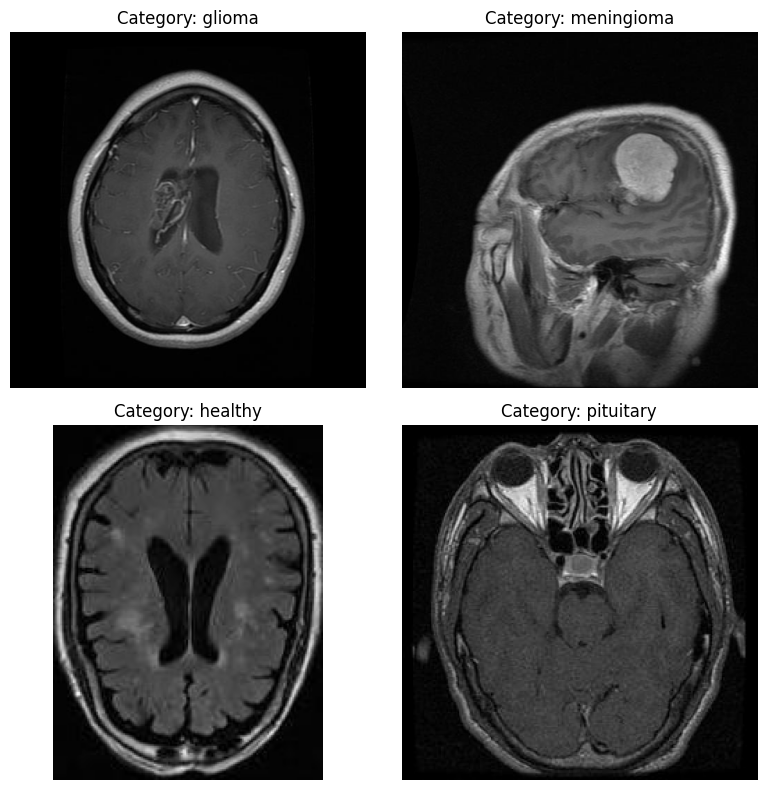

In [ ]:
fig, axs = plt.subplots(2, 2, figsize=(8, 8))

for i, category in enumerate(CATEGORIES):
    row, col = divmod(i, 2)

    # List all images in the category's folder
    path = os.path.join(DATADIR, category)
    image_files = os.listdir(path)

    # Choose a image from each category
    if image_files:
        img_path = cv2.imread(os.path.join(path, image_files[0]), cv2.COLOR_BGR2RGB)
        # Display the image in the corresponding subplot
        axs[row, col].imshow(img_path, cmap="gray")
        axs[row, col].set_title(f"Category: {category}")
        axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# Data Preprocessing

In [ ]:
X = []
y = []

IMG_SIZE = 224

# Create a dictionary to track image counts
image_counts = {category: 0 for category in CATEGORIES}

for category in CATEGORIES:
    path = os.path.join(DATADIR, category)
    class_num = CATEGORIES.index(category)

    for img in os.listdir(path):
        try:
            img_array = cv2.cvtColor(cv2.imread(os.path.join(path, img)), cv2.COLOR_BGR2RGB)
            if img_array is not None:
                new_array = cv2.resize(img_array, (IMG_SIZE, IMG_SIZE))
                X.append(new_array)
                y.append(class_num)
                image_counts[category] += 1  # Track count for each category
        except Exception as e:
            print(f"Error reading image {img} in {category}: {e}")

# Print detailed image counts
for category, count in image_counts.items():
    print(f"{category}: {count} images")

print(f"\nTotal images: {len(X)}")
print(f"Total labels: {len(y)}")

glioma: 1621 images
meningioma: 1645 images
healthy: 2000 images
pituitary: 1757 images

Total images: 7023
Total labels: 7023


In [ ]:
# First, split off the test set
x_train_and_valid, x_test, y_train_and_valid, y_test = train_test_split(
    X, y,
    test_size=0.15,
    random_state=42,
    shuffle=True,
    stratify=y
)

# Then split the remaining into train and validation
x_train, x_valid, y_train, y_valid = train_test_split(
    x_train_and_valid, y_train_and_valid,
    test_size=0.15/(1-0.15),  # Proportional split
    random_state=42,
    shuffle=True,
    stratify=y_train_and_valid
)

In [ ]:
# Convert lists to NumPy arrays
x_train_split = np.array(x_train)
x_valid_split = np.array(x_valid)
x_test = np.array(x_test)
y_train_split = np.array(y_train)
y_valid_split = np.array(y_valid)
y_test = np.array(y_test)

In [ ]:
print('x_train:\t{}'.format(x_train_split.shape))
print('y_train:\t{}'.format(y_train_split.shape))
print('x_valid:\t{}'.format(x_valid_split.shape))
print('y_valid:\t{}'.format(y_valid_split.shape))
print('x_test:\t\t{}'.format(x_test.shape))
print('y_test:\t\t{}'.format(y_test.shape))

x_train:	(4915, 224, 224, 3)
y_train:	(4915,)
x_valid:	(1054, 224, 224, 3)
y_valid:	(1054,)
x_test:		(1054, 224, 224, 3)
y_test:		(1054,)


### EDA Training and Test Sets

In [ ]:
# Verify class distribution
def print_class_distribution(y, dataset_name):
    unique, counts = np.unique(y, return_counts=True)
    print(f"\nClass distribution for {dataset_name}:")
    for label, count in zip(unique, counts):
        print(f"Class {label}: {count} ({count/len(y)*100:.2f}%)")

print_class_distribution(y, "Original Dataset")
print_class_distribution(y_train, "Training Set")
print_class_distribution(y_test, "Test Set")
print_class_distribution(y_train_split, "Training Split")
print_class_distribution(y_valid_split, "Validation Split")


Class distribution for Original Dataset:
Class 0: 1621 (23.08%)
Class 1: 1645 (23.42%)
Class 2: 2000 (28.48%)
Class 3: 1757 (25.02%)

Class distribution for Training Set:
Class 0: 1135 (23.09%)
Class 1: 1151 (23.42%)
Class 2: 1400 (28.48%)
Class 3: 1229 (25.01%)

Class distribution for Test Set:
Class 0: 243 (23.06%)
Class 1: 247 (23.43%)
Class 2: 300 (28.46%)
Class 3: 264 (25.05%)

Class distribution for Training Split:
Class 0: 1135 (23.09%)
Class 1: 1151 (23.42%)
Class 2: 1400 (28.48%)
Class 3: 1229 (25.01%)

Class distribution for Validation Split:
Class 0: 243 (23.06%)
Class 1: 247 (23.43%)
Class 2: 300 (28.46%)
Class 3: 264 (25.05%)


In [ ]:
print("First ten labels training dataset:\n {}\n".format(y_train_split[0:10]))

First ten labels training dataset:
 [1 0 3 0 3 0 0 0 1 0]



### Display Frequency of Each Class

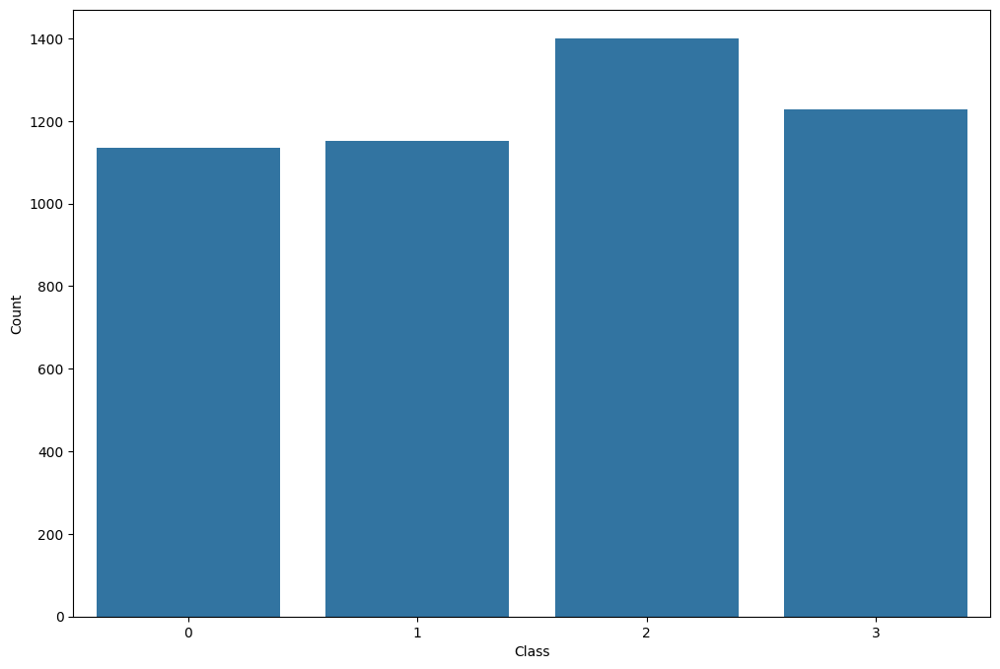

In [ ]:
plt.figure(figsize = (12 ,8))
items = [{'Class': X, 'Count': y} for X, y in Counter(y_train_split).items()]
distribution = pd.DataFrame(items).sort_values(['Class'])
sns.barplot(x=distribution.Class, y=distribution.Count);

In [ ]:
Counter(y_train_split).most_common()

[(2, 1400), (3, 1229), (1, 1151), (0, 1135)]

In [ ]:
Counter(y_test).most_common()

[(2, 300), (3, 264), (1, 247), (0, 243)]

### Plot Sample images to observe Variability within classes

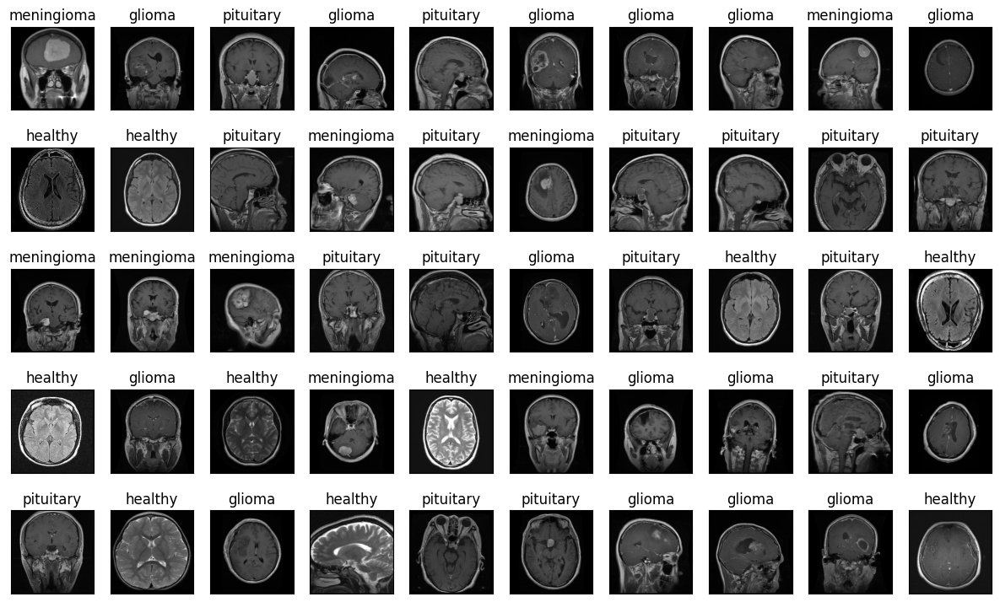

In [ ]:
fig = plt.figure(figsize = (15, 9))

for i in range(50):
    plt.subplot(5, 10, 1+i)
    plt.title(CATEGORIES[y_train[i]])  # Convert numeric label to category name
    plt.xticks([])
    plt.yticks([])
    plt.imshow(x_train[i])

In [ ]:
print(x_train_split.shape, x_valid_split.shape, x_test.shape)

(4915, 224, 224, 3) (1054, 224, 224, 3) (1054, 224, 224, 3)


### Normalize the dataset

In [ ]:
x_train_norm = x_train_split/ 255.0
x_valid_norm = x_valid_split/ 255.0
x_test_norm = x_test/ 255.0

In [ ]:
print("Shape of x_train_norm:", x_train_norm.shape)
print("Shape of y_train_split:", y_train_split.shape)

Shape of x_train_norm: (4915, 224, 224, 3)
Shape of y_train_split: (4915,)


## Build Baseline CNN

### Experiment 1

In [ ]:
# Clear the session
tf.keras.backend.clear_session()

# Define the input layer
inputs = layers.Input(shape=(224, 224, 3))

# First convolutional and pooling layers
x = layers.Conv2D(filters=32, kernel_size=3, activation="relu")(inputs)
x = layers.MaxPooling2D(pool_size=2)(x)

# Second convolutional and pooling layers
x = layers.Conv2D(filters=64, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)

# Flatten and define the dense output layer
x = layers.Flatten()(x)
outputs = layers.Dense(4, activation="softmax")(x)

model_1 = Model(inputs=inputs, outputs=outputs)

model_1.summary()


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 222, 222, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 111, 111, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 109, 109, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 54, 54, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 186624)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 4)                   │         746,500 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 765,892 (2.92 MB)

 Trainable params: 765,892 (2.92 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Compile the Model

model_1.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

# Train the Model

start_time_1 = time.time()

model_1_history = model_1.fit(x_train_norm
                    ,y_train_split
                    ,epochs=15
                    ,batch_size=64
                    ,validation_data=(x_valid_norm, y_valid_split)
                    ,callbacks=[
                     tf.keras.callbacks.ModelCheckpoint("CNN_model.E1.keras",save_best_only=True,save_weights_only=False)
                    ])

end_time_1 = time.time()

Epoch 1/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 16s 120ms/step - accuracy: 0.5074 - loss: 1.4649 - val_accuracy: 0.8159 - val_loss: 0.5180
Epoch 2/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 2s 24ms/step - accuracy: 0.8715 - loss: 0.3584 - val_accuracy: 0.8871 - val_loss: 0.3232
Epoch 3/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 2s 24ms/step - accuracy: 0.9417 - loss: 0.1857 - val_accuracy: 0.9061 - val_loss: 0.2694
Epoch 4/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step - accuracy: 0.9786 - loss: 0.0837 - val_accuracy: 0.9004 - val_loss: 0.2957
Epoch 5/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 2s 24ms/step - accuracy: 0.9810 - loss: 0.0654 - val_accuracy: 0.9241 - val_loss: 0.2396
Epoch 6/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 2s 24ms/step - accuracy: 0.9974 - loss: 0.0253 - val_accuracy: 0.9260 - val_loss: 0.2636
Epoch 7/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step - accuracy: 0.9984 - loss: 0.0132 - val_accuracy: 0.9269 - val_loss: 0.2652
Epoch 8/15
77/77 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step - accuracy: 0.9997 - loss: 0.0061 - val_accuracy: 0.9260 -

In [ ]:
# Print Process Time

runtime_1 = end_time_1 - start_time_1
print("Runtime: {:.2f} seconds".format(runtime_1))

epochs_1 = len(model_1_history.history['accuracy'])
print(f"Model 1 had {epochs_1} epochs")

Runtime: 47.03 seconds
Model 1 had 15 epochs


### Test Model 1

In [ ]:
# Run the model on test data

test_results_1 = model_1.evaluate(x_test_norm, y_test, verbose=0)[1]
print("Test accuracy: {:.4f}%".format(test_results_1))

Test accuracy: 0.9450%


In [ ]:
# Get Predictions for Model 1
predictions_model1 = np.argmax(model_1.predict(x_test_norm), axis=1)
print("Shape of predictions model 1:", predictions_model1.shape)

33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
Shape of predictions model 1: (1054,)


### Call Plot Functions

Model 1: Baseline Model 



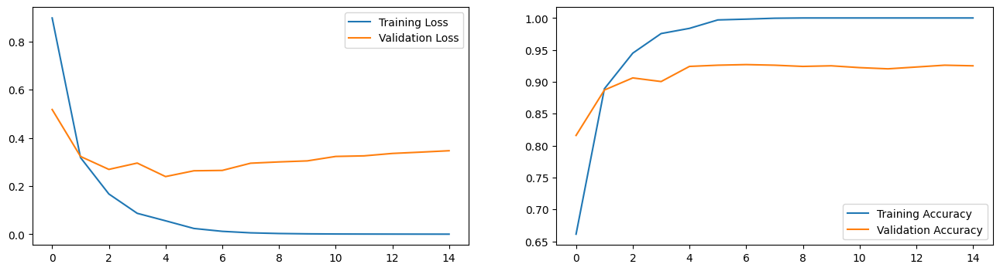

In [ ]:
print("Model 1: Baseline Model", "\n")
plot_history(model_1_history)

### Experiment 2: Add Layers, Regularization and Hyperparams

In [ ]:
tf.keras.backend.clear_session()

inputs = layers.Input(shape=(224, 224, 3))

# Define the first convolutional block with dropout
x = layers.Conv2D(filters=32, kernel_size=3, activation="relu", padding='same', kernel_regularizer=regularizers.l2(0.001))(inputs)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Dropout(0.2)(x)

# Define the second convolutional block with dropout
x = layers.Conv2D(filters=64,kernel_size=3,activation="relu",padding='same', kernel_regularizer=regularizers.l2(0.001))(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Dropout(0.2)(x)

# Define the third convolutional block with dropout
x = layers.Conv2D(filters=128, kernel_size=3, activation="relu", padding='same', kernel_regularizer=regularizers.l2(0.001))(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Dropout(0.2)(x)

# Flatten the output from the convolutional layers
x = layers.Flatten()(x)

# Define the dense layer with dropout
x = layers.Dense(128, activation="relu", kernel_regularizer=regularizers.l2(0.001))(x)
x = layers.Dropout(0.2)(x)

outputs = layers.Dense(4, activation="softmax")(x)

model_2 = Model(inputs=inputs, outputs=outputs)

model_2.summary()


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 224, 224, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 112, 112, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 112, 112, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 112, 112, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 56, 56, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 56, 56, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 56, 56, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 28, 28, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 28, 28, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 100352)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │      12,845,184 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 4)                   │             516 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 12,938,948 (49.36 MB)

 Trainable params: 12,938,948 (49.36 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Compile the Model

optimizer = Adam(learning_rate=0.0001)
model_2.compile(optimizer=optimizer,
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

# Train the Model
start_time_2 = time.time()

model_2_history = model_2.fit(x_train_norm
                    ,y_train_split
                    ,epochs=25
                    ,batch_size=64
                    ,validation_data=(x_valid_norm, y_valid_split)
                    ,callbacks=[
                     tf.keras.callbacks.ModelCheckpoint("CNN_model.E2.keras",save_best_only=True,save_weights_only=False),
                     tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
                    ])

end_time_2 = time.time()

Epoch 1/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 21s 173ms/step - accuracy: 0.5077 - loss: 1.4633 - val_accuracy: 0.6907 - val_loss: 1.1229
Epoch 2/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 37ms/step - accuracy: 0.7107 - loss: 1.0252 - val_accuracy: 0.6822 - val_loss: 1.0295
Epoch 3/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 37ms/step - accuracy: 0.7694 - loss: 0.8571 - val_accuracy: 0.7666 - val_loss: 0.8424
Epoch 4/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 37ms/step - accuracy: 0.8116 - loss: 0.7271 - val_accuracy: 0.7837 - val_loss: 0.7820
Epoch 5/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 37ms/step - accuracy: 0.8562 - loss: 0.6211 - val_accuracy: 0.8254 - val_loss: 0.6992
Epoch 6/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 37ms/step - accuracy: 0.8573 - loss: 0.5914 - val_accuracy: 0.8510 - val_loss: 0.6409
Epoch 7/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 36ms/step - accuracy: 0.8915 - loss: 0.5284 - val_accuracy: 0.8444 - val_loss: 0.6082
Epoch 8/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 37ms/step - accuracy: 0.9072 - loss: 0.4788 - val_accuracy: 0.8776 -

In [ ]:
# Print Run Time

runtime_2 = end_time_2 - start_time_2
print("Runtime: {:.2f} seconds".format(runtime_2))

epochs_2 = len(model_2_history.history['accuracy'])
print(f"Model 2 had {epochs_2} epochs")

Runtime: 75.85 seconds
Model 2 had 20 epochs


### Test Model 2

In [ ]:
# Run the model on test data

test_results_2 = model_2.evaluate(x_test_norm, y_test, verbose=0)[1]
print("Test accuracy: {:.4f}%".format(test_results_2))

Test accuracy: 0.9345%


In [ ]:
# Get Predictions for Model 2
predictions_model2 = np.argmax(model_2.predict(x_test_norm), axis=1)
print("Shape of predictions model 2:", predictions_model2.shape)

33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step
Shape of predictions model 2: (1054,)


### Call Plot Functions

Model 2: Complex Model 



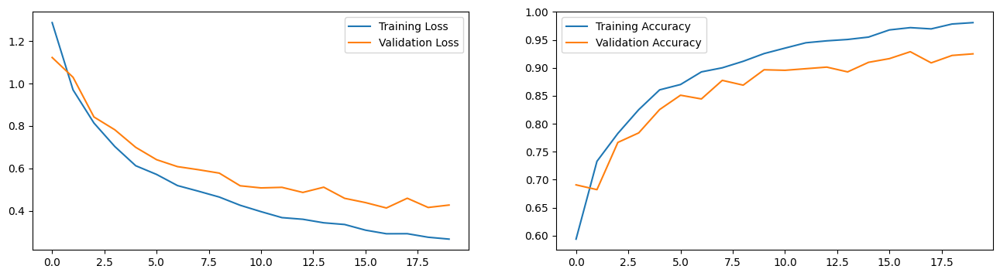

In [ ]:
print("Model 2: Complex Model", "\n")
plot_history(model_2_history)

### Experiment 3: Update Model Architecture

In [ ]:
tf.keras.backend.clear_session()

# Define the input layer
inputs = layers.Input(shape=(224, 224, 3))

# Define the first convolutional and pooling layers
x = layers.Conv2D(filters=32,kernel_size=3, activation="relu", padding='same',
    kernel_regularizer=regularizers.l2(0.001))(inputs)
x = layers.MaxPooling2D(pool_size=2)(x)

# Define the second convolutional and pooling layers
x = layers.Conv2D(filters=64,kernel_size=3, activation="relu", padding='same',
    kernel_regularizer=regularizers.l2(0.001))(x)
x = layers.MaxPooling2D(pool_size=2)(x)

# Define the third convolutional and pooling layers
x = layers.Conv2D(
    filters=128, kernel_size=3, activation="relu", padding='same',
    kernel_regularizer=regularizers.l2(0.001))(x)
x = layers.MaxPooling2D(pool_size=2)(x)

# Flatten the output from the convolutional layers
x = layers.Flatten()(x)

# Define the dense layers with dropout
x = layers.Dense(256,activation="relu", kernel_regularizer=regularizers.l2(0.001))(x)
x = layers.Dropout(0.2)(x)

outputs = layers.Dense(4, activation="softmax")(x)

model_3 = Model(inputs=inputs, outputs=outputs)

# Summarize the model
model_3.summary()



Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 224, 224, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 112, 112, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 112, 112, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 56, 56, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 56, 56, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 28, 28, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 100352)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 256)                 │      25,690,368 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 4)                   │           1,028 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 25,784,644 (98.36 MB)

 Trainable params: 25,784,644 (98.36 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Compile the Model

model_3.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

# Train the Model

start_time_3 = time.time()

model_3_history = model_3.fit(x_train_norm
                    ,y_train_split
                    ,epochs=50
                    ,batch_size=64
                    ,validation_data=(x_valid_norm, y_valid_split)
                    ,callbacks=[
                     tf.keras.callbacks.ModelCheckpoint("CNN_model.E2.keras",save_best_only=True,save_weights_only=False),
                     tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
                    ])

end_time_3 = time.time()

Epoch 1/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 21s 173ms/step - accuracy: 0.4959 - loss: 1.6844 - val_accuracy: 0.7856 - val_loss: 0.8049
Epoch 2/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.8112 - loss: 0.7379 - val_accuracy: 0.8416 - val_loss: 0.6555
Epoch 3/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.8544 - loss: 0.6077 - val_accuracy: 0.8435 - val_loss: 0.6294
Epoch 4/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 45ms/step - accuracy: 0.8816 - loss: 0.5687 - val_accuracy: 0.9042 - val_loss: 0.4935
Epoch 5/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step - accuracy: 0.9280 - loss: 0.4341 - val_accuracy: 0.8918 - val_loss: 0.5528
Epoch 6/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - accuracy: 0.9307 - loss: 0.4291 - val_accuracy: 0.8852 - val_loss: 0.5444
Epoch 7/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 45ms/step - accuracy: 0.9451 - loss: 0.3879 - val_accuracy: 0.9279 - val_loss: 0.4526
Epoch 8/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 45ms/step - accuracy: 0.9589 - loss: 0.3539 - val_accuracy: 0.9393 -

In [ ]:
# Print Run Time

runtime_3 = end_time_3 - start_time_3
print("Runtime: {:.2f} seconds".format(runtime_3))

epochs_3 = len(model_3_history.history['accuracy'])
print(f"Model 3 had {epochs_3} epochs")

Runtime: 88.91 seconds
Model 3 had 24 epochs


### Test Model 3

In [ ]:
# Run the model on test data

test_results_3 = model_3.evaluate(x_test_norm, y_test, verbose=0)[1]
print("Test accuracy: {:.4f}%".format(test_results_3))

Test accuracy: 0.9611%


In [ ]:
# Get Predictions for Model 3
predictions_model3 = np.argmax(model_3.predict(x_test_norm), axis=1)
print("Shape of predictions model 3:", predictions_model3.shape)

33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step
Shape of predictions model 3: (1054,)


### Plot the training curves

Model 3: Updated Model 



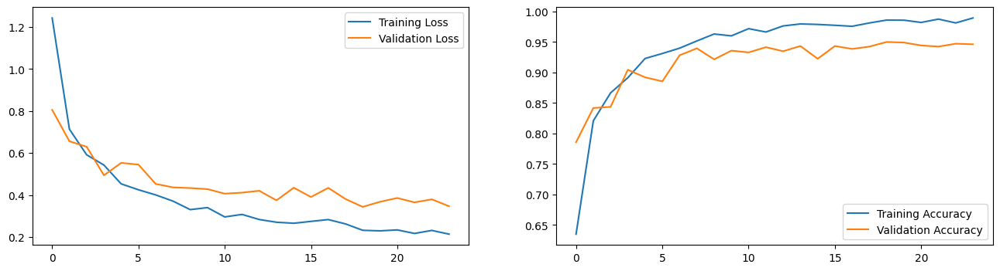

In [ ]:
print("Model 3: Updated Model", "\n")
plot_history(model_3_history)

Model 3: Confusion Matrix 



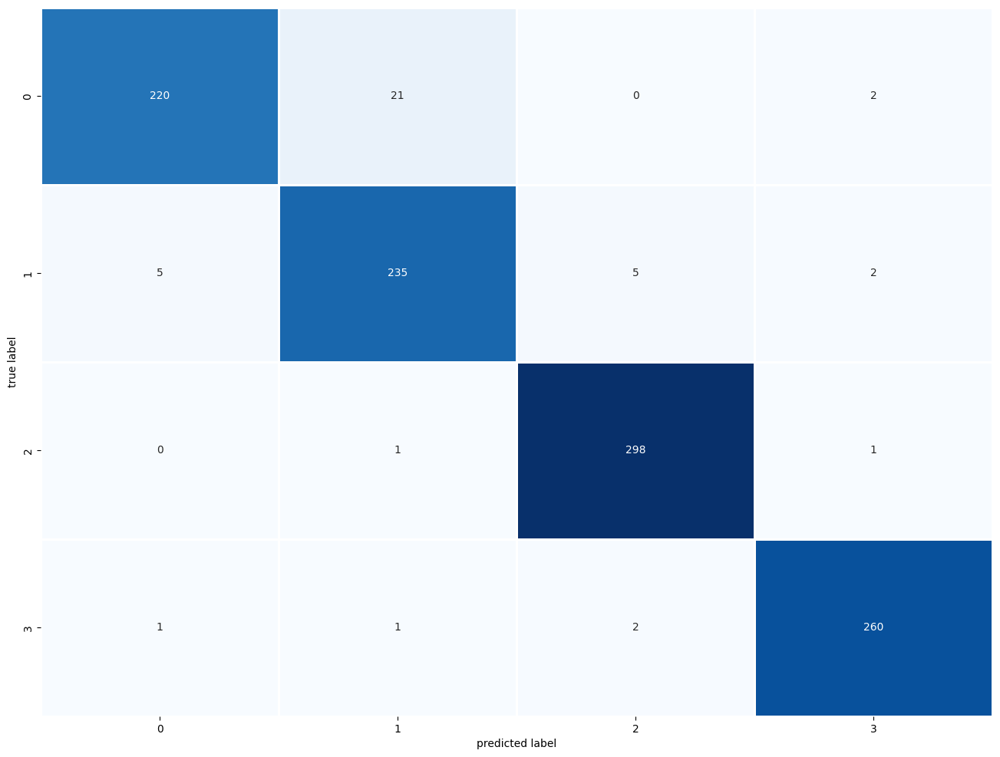

In [ ]:
print("Model 3: Confusion Matrix", "\n")
plot_confusion_matrix(y_test, predictions_model3)

In [ ]:
# Print Validation Report
print("Model 3: Validation Report", "\n")
print_validation_report(y_test, predictions_model3)

Model 3: Validation Report 

Classification Report
              precision    recall  f1-score   support

           0       0.90      0.91      0.91       243
           1       0.90      0.89      0.90       247
           2       0.99      0.99      0.99       300
           3       0.98      0.98      0.98       264

    accuracy                           0.95      1054
   macro avg       0.94      0.94      0.94      1054
weighted avg       0.95      0.95      0.95      1054

Accuracy Score: 0.9468690702087287
Root Mean Square Error: 0.31712656773289954


### Extract Activation Features

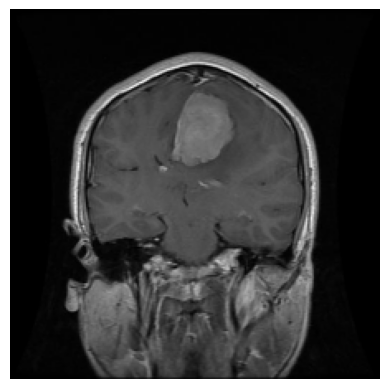

In [ ]:
test_images = x_test
test_labels = y_test

img = test_images[20]
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)

class_names = ['glioma'
,'meningioma'
,'healthy'
,'pituitary']

plt.imshow(img, cmap='viridis')
plt.axis('off')
plt.show()

In [ ]:
layer_outputs = [layer.output for layer in model_3.layers[:6]]
# Creates a model that will return these outputs, given the model input:
activation_model = models.Model(inputs=model_3.input, outputs=layer_outputs)

In [ ]:
activations = activation_model.predict(img_tensor)
len(activations)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


6

In [ ]:
layer_names = []
for layer in model_3.layers:
    layer_names.append(layer.name)

layer_names

['input_layer',
 'conv2d',
 'max_pooling2d',
 'conv2d_1',
 'max_pooling2d_1',
 'conv2d_2',
 'max_pooling2d_2',
 'flatten',
 'dense',
 'dropout',
 'dense_1']

<ipython-input-50-200b6d3715df>:40: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
<ipython-input-50-200b6d3715df>:27: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std()
<ipython-input-50-200b6d3715df>:30: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')
/usr/local/lib/python3.10/dist-packages/matplotlib/_tight_bbox.py:67: RuntimeWarning: divide by zero encountered in scalar divide
  fig.patch.set_bounds(x0 / w1, y0 / h1,
/usr/local/lib/python3.10/dist-packages/matplotlib/_tight_bbox.py:68: RuntimeWarning: divide by zero encountered in scalar divide
  fig.bbox.width / w1, fig.bbox.height / h1)
/usr/local/lib/python3.10/dist-packages/matplotlib/patches.py:743: RuntimeWarning: invalid value encountered in scalar add
  y1 = self.convert_yunits(self._y0 + self.

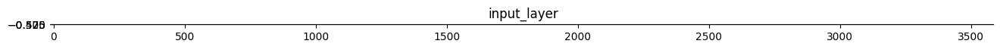

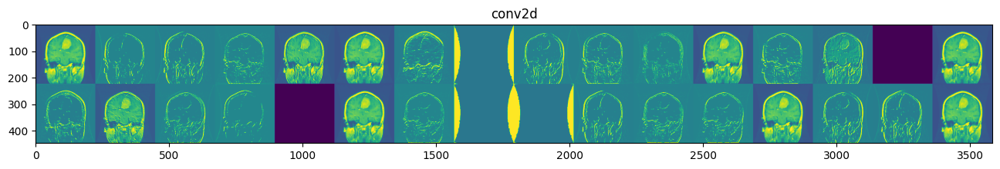

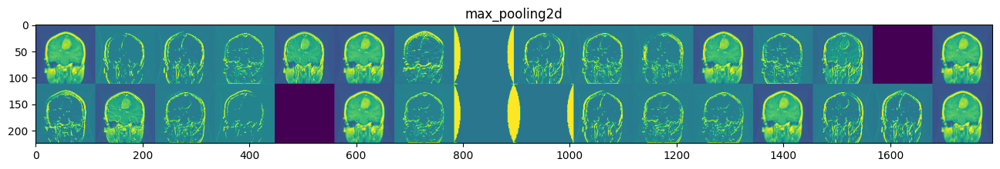

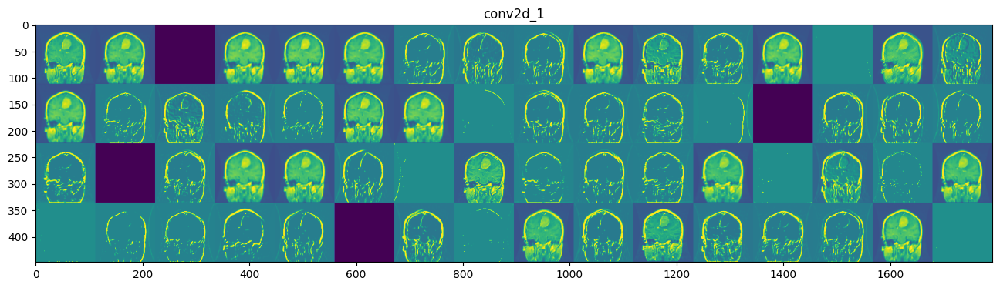

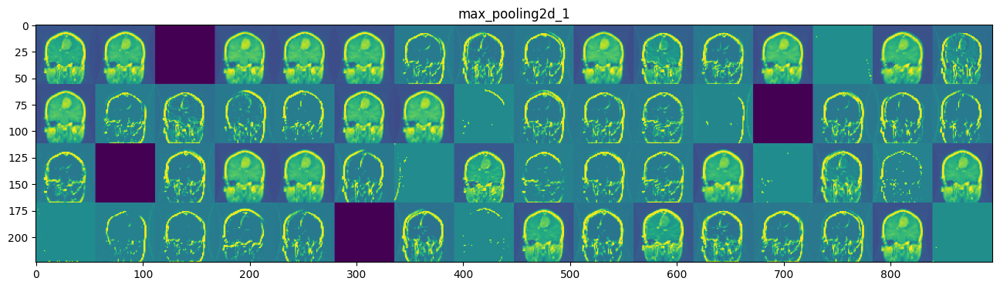

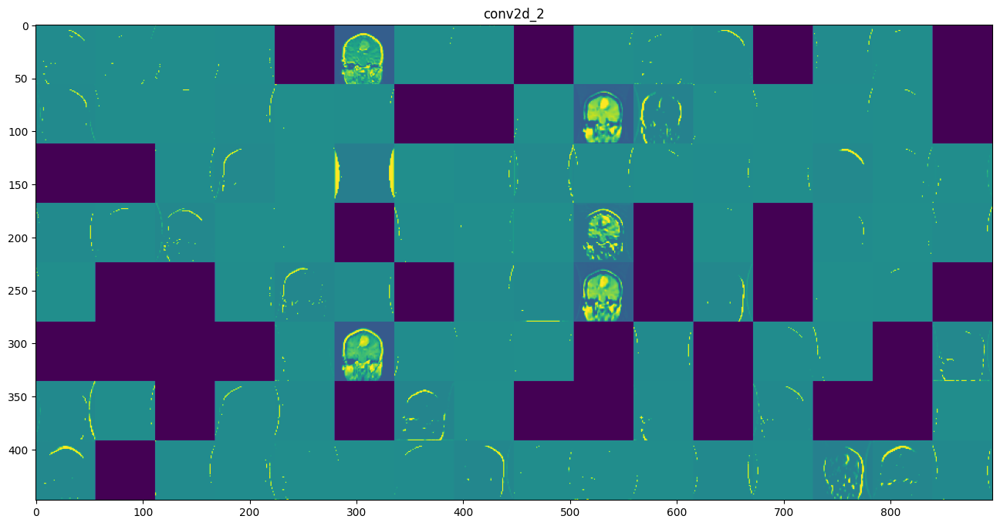

In [ ]:
layer_names = []
for layer in model_3.layers[:6]:
    layer_names.append(layer.name)

images_per_row = 16

# display the feature maps
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    # tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

plt.show();

### Experiment 4: Use ResNet50 Model

In [ ]:
tf.keras.backend.clear_session()

# Define the base model (ResNet50), exclude the top layer (include_top=False)
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(IMG_SIZE, IMG_SIZE, 3))

# Freeze the base model layers (for transfer learning)
base_model.trainable = False

inputs = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
x = base_model(inputs, training=False)  # Pass input through base model
x = layers.GlobalAveragePooling2D()(x)  # Apply Global Average Pooling
x = layers.Dense(256, activation='relu')(x)
outputs = layers.Dense(4, activation='softmax')(x)  # Output layer

# Define the model
model_4 = models.Model(inputs, outputs)

# Print the model summary to verify
model_4.summary()


94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ resnet50 (Functional)                │ (None, 7, 7, 2048)          │      23,587,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 2048)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 256)                 │         524,544 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 4)                   │           1,028 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 24,113,284 (91.98 MB)

 Trainable params: 525,572 (2.00 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [ ]:
# Complile the Model

model_4.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

# Train the model

start_time_4 = time.time()

model_4_history = model_4.fit(x_train_norm
                    ,y_train_split
                    ,epochs=25
                    ,batch_size=64
                    ,validation_data=(x_valid_norm, y_valid_split)
                    ,callbacks=[
                     tf.keras.callbacks.ModelCheckpoint("CNN_model.E4.keras",save_best_only=True,save_weights_only=False)
                    ])

end_time_4 = time.time()

Epoch 1/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 36s 289ms/step - accuracy: 0.4095 - loss: 1.2540 - val_accuracy: 0.6471 - val_loss: 0.9675
Epoch 2/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 49ms/step - accuracy: 0.5974 - loss: 0.9942 - val_accuracy: 0.6860 - val_loss: 0.8411
Epoch 3/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 48ms/step - accuracy: 0.6551 - loss: 0.8688 - val_accuracy: 0.7287 - val_loss: 0.7664
Epoch 4/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 49ms/step - accuracy: 0.6791 - loss: 0.8060 - val_accuracy: 0.7381 - val_loss: 0.7050
Epoch 5/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.6919 - loss: 0.7568 - val_accuracy: 0.7362 - val_loss: 0.7257
Epoch 6/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 49ms/step - accuracy: 0.7083 - loss: 0.7085 - val_accuracy: 0.7410 - val_loss: 0.6602
Epoch 7/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 48ms/step - accuracy: 0.7389 - loss: 0.6733 - val_accuracy: 0.7723 - val_loss: 0.6135
Epoch 8/25
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 49ms/step - accuracy: 0.7365 - loss: 0.6562 - val_accuracy: 0.7770 -

In [ ]:
# Get Run Time
runtime_4 = end_time_4 - start_time_4
print("Runtime: {:.2f} seconds".format(runtime_4))

epochs_4 = len(model_4_history.history['accuracy'])
print(f"Model 4 had {epochs_4} epochs")

Runtime: 122.01 seconds
Model 4 had 25 epochs


In [ ]:
# Evaluate the model
test_results_4 = model_4.evaluate(x_test_norm, y_test, verbose=0)[1]
print("Test accuracy: {:.4f}%".format(test_results_4))

Test accuracy: 0.7799%


In [ ]:
# Get Predictions
predictions_model4 = np.argmax(model_4.predict(x_test_norm), axis=1)
print("Shape of predictions model 4:", predictions_model4.shape)

33/33 ━━━━━━━━━━━━━━━━━━━━ 8s 147ms/step
Shape of predictions model 4: (1054,)


Model 4: ResNet50 Base Model 



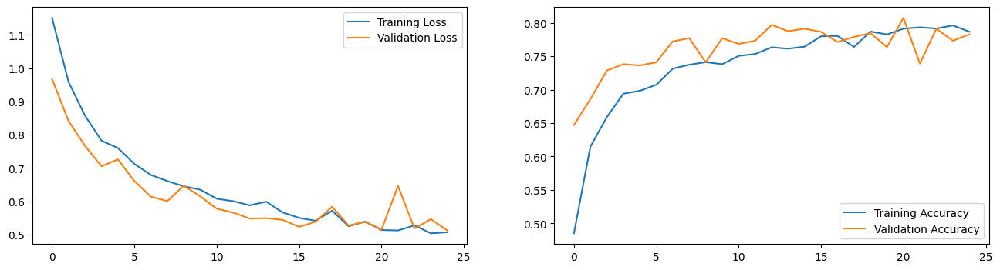

None


In [ ]:
# Get Training Plots
print("Model 4: ResNet50 Base Model", "\n")
print(plot_history(model_4_history))

Model 4: Confusion Matrix 

None


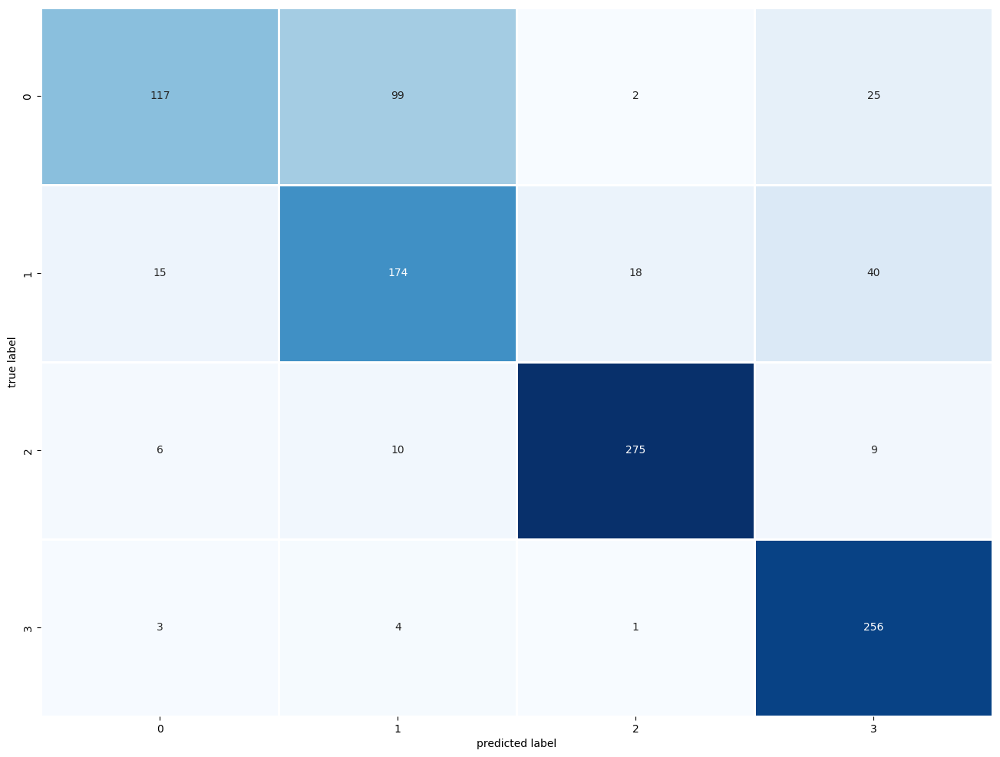

In [ ]:
# Get Confusion Matrix
print("Model 4: Confusion Matrix", "\n")
print(plot_confusion_matrix(y_test, predictions_model4))

## Experiment 5: ResNet with Regularization and Hyperparam Tuning

In [ ]:
tf.keras.backend.clear_session()


# Define the base model (ResNet50), exclude the top layer (include_top=False)
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(IMG_SIZE, IMG_SIZE, 3))

base_model.trainable = False
inputs = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
x = layers.ZeroPadding2D(padding=((3, 3), (3, 3)))(inputs)
x = base_model(inputs, training=False)
x = layers.GlobalAveragePooling2D()(x)

x = layers.Dense(128, activation='relu', kernel_regularizer=l2(0.001))(x)
x = layers.Dense(64, activation='relu', kernel_regularizer=l2(0.001))(x)
x = layers.Dense(32, activation='relu', kernel_regularizer=l2(0.001))(x)

outputs = layers.Dense(4, activation='softmax')(x)

# Define the model
model_5 = models.Model(inputs, outputs)

# Print the model summary to verify
model_5.summary()


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ resnet50 (Functional)                │ (None, 7, 7, 2048)          │      23,587,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 2048)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 32)                  │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 4)                   │             132 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 23,860,452 (91.02 MB)

 Trainable params: 272,740 (1.04 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [ ]:
# Complile the Model

model_5.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

# Train the model

start_time_5 = time.time()

model_5_history = model_5.fit(x_train_norm
                    ,y_train_split
                    ,epochs=50
                    ,batch_size=64
                    ,validation_data=(x_valid_norm, y_valid_split)
                    ,callbacks=[
                     tf.keras.callbacks.ModelCheckpoint("CNN_model.E5.keras",save_best_only=True,save_weights_only=False),
                     tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
                    ])

end_time_5 = time.time()

Epoch 1/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 38s 298ms/step - accuracy: 0.3747 - loss: 1.5202 - val_accuracy: 0.4991 - val_loss: 1.1788
Epoch 2/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 50ms/step - accuracy: 0.5459 - loss: 1.1649 - val_accuracy: 0.6148 - val_loss: 1.0390
Epoch 3/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 50ms/step - accuracy: 0.6059 - loss: 1.0539 - val_accuracy: 0.7381 - val_loss: 0.8931
Epoch 4/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 50ms/step - accuracy: 0.6598 - loss: 0.9518 - val_accuracy: 0.7116 - val_loss: 0.8763
Epoch 5/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 50ms/step - accuracy: 0.6824 - loss: 0.8874 - val_accuracy: 0.7694 - val_loss: 0.7571
Epoch 6/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.6893 - loss: 0.8454 - val_accuracy: 0.7249 - val_loss: 0.7702
Epoch 7/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 49ms/step - accuracy: 0.7211 - loss: 0.7967 - val_accuracy: 0.7476 - val_loss: 0.7253
Epoch 8/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7319 - loss: 0.7691 - val_accuracy: 0.7125 -

In [ ]:
# Get Runtime
runtime_5 = end_time_5 - start_time_5
print("Runtime: {:.2f} seconds".format(runtime_5))

epochs_5 = len(model_5_history.history['accuracy'])
print(f"Model 5 had {epochs_5} epochs")

Runtime: 90.12 seconds
Model 5 had 15 epochs


In [ ]:
# Test Model 5
test_results_5 = model_5.evaluate(x_test_norm, y_test, verbose=0)[1]
print("Test accuracy: {:.4f}%".format(test_results_5))

Test accuracy: 0.7571%


In [ ]:
predictions_model5 = np.argmax(model_5.predict(x_test_norm), axis=1)
print("Shape of predictions model 5:", predictions_model5.shape)

33/33 ━━━━━━━━━━━━━━━━━━━━ 8s 125ms/step
Shape of predictions model 5: (1054,)


Model 5: ResNet50 Base Model 



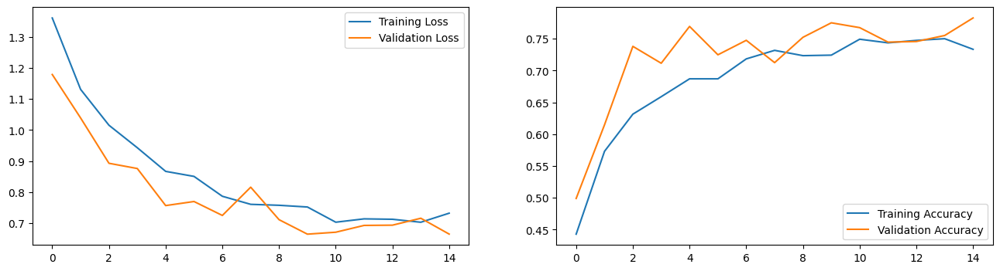

None


In [ ]:
print("Model 5: ResNet50 Base Model", "\n")
print(plot_history(model_5_history))

Model 5: Confusion Matrix 

None


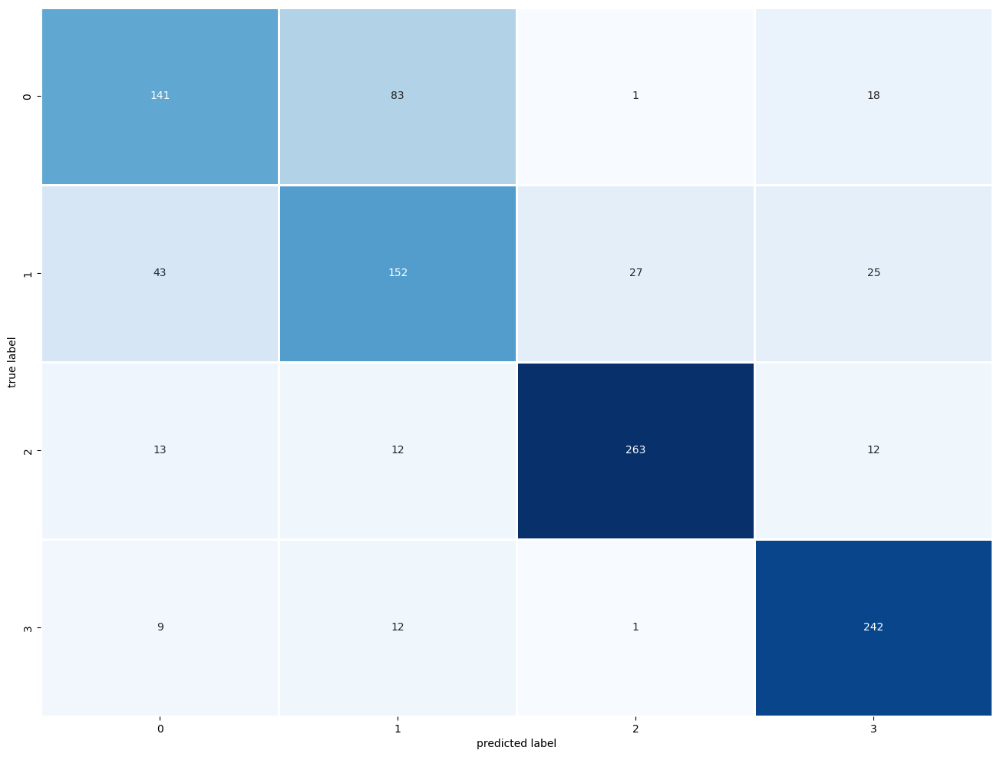

In [ ]:
print("Model 5: Confusion Matrix", "\n")
print(plot_confusion_matrix(y_test, predictions_model5))

## Experiment 6: Data Augmentation

In [ ]:
tf.keras.backend.clear_session()

# Define data augmentation
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal_and_vertical"),
    tf.keras.layers.RandomRotation(0.1),
    tf.keras.layers.RandomContrast(0.1),
])

# Load base model
base_model = tf.keras.applications.ResNet50(
    weights='imagenet',
    include_top=False,
    input_shape=(IMG_SIZE, IMG_SIZE, 3),
)
base_model.trainable = False  # Freeze the base model

# Build the model
inputs = tf.keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))

# Apply data augmentation
x = data_augmentation(inputs)

# Preprocess input for ResNet50
x = tf.keras.applications.resnet50.preprocess_input(x)

# Pass through the base model
x = base_model(x, training=False)

# Flatten and add Dense layers
x = layers.Flatten()(x)

# Output layer
outputs = layers.Dense(4, activation='softmax')(x)

# Create the model
model_6 = tf.keras.Model(inputs, outputs)

model_6.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential (Sequential)   │ (None, 224, 224, 3)    │              0 │ input_layer_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ get_item (GetItem)        │ (None, 224, 224)       │              0 │ sequential[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ get_item_1 (GetItem)      │ (None, 224, 224)       │              0 │ sequential[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ get_item_2 (GetItem)      │ (None, 224, 224)       │              0 │ sequential[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stack (Stack)             │ (None, 224, 224, 3)    │              0 │ get_item[0][0],        │
│                           │                        │                │ get_item_1[0][0],      │
│                           │                        │                │ get_item_2[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add (Add)                 │ (None, 224, 224, 3)    │              0 │ stack[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ resnet50 (Functional)     │ (None, 7, 7, 2048)     │     23,587,712 │ add[0][0]              │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 100352)         │              0 │ resnet50[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 4)              │        401,412 │ flatten[0][0]          │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 23,989,124 (91.51 MB)

 Trainable params: 401,412 (1.53 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [ ]:
# Complile the Model

model_6.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

# Train the model

start_time_6 = time.time()

# Change save_weights_only to True
model_6_history = model_6.fit(x_train_norm
                    ,y_train_split
                    ,epochs=50
                    ,batch_size=64
                    ,validation_data=(x_valid_norm, y_valid_split)
                    ,callbacks=[
                     tf.keras.callbacks.ModelCheckpoint("CNN_model.E6.keras",save_best_only=True,save_weights_only=False),
                     tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
                    ])

end_time_6 = time.time()

Epoch 1/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 15s 108ms/step - accuracy: 0.4202 - loss: 3.5456 - val_accuracy: 0.6708 - val_loss: 0.8000
Epoch 2/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 5s 69ms/step - accuracy: 0.6543 - loss: 0.8347 - val_accuracy: 0.7182 - val_loss: 0.7276
Epoch 3/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 5s 69ms/step - accuracy: 0.6327 - loss: 1.0953 - val_accuracy: 0.7524 - val_loss: 0.6523
Epoch 4/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 5s 69ms/step - accuracy: 0.6802 - loss: 0.8235 - val_accuracy: 0.7609 - val_loss: 0.6207
Epoch 5/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 58ms/step - accuracy: 0.7362 - loss: 0.7118 - val_accuracy: 0.6879 - val_loss: 0.8593
Epoch 6/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 58ms/step - accuracy: 0.6670 - loss: 0.8686 - val_accuracy: 0.7211 - val_loss: 0.9284
Epoch 7/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.7122 - loss: 0.7832 - val_accuracy: 0.7381 - val_loss: 0.6540
Epoch 8/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 58ms/step - accuracy: 0.7143 - loss: 0.7059 - val_accuracy: 0.7154 -

In [ ]:
# Processing Time
runtime_6 = end_time_6 - start_time_6
print("Runtime: {:.2f} seconds".format(runtime_6))

epochs_6 = len(model_6_history.history['accuracy'])
print(f"Model 6 had {epochs_6} epochs")

Runtime: 57.06 seconds
Model 6 had 9 epochs


In [ ]:
# Evaluate the model
test_results_6 = model_6.evaluate(x_test_norm, y_test, verbose=0)[1]
print("Test accuracy: {:.4f}%".format(test_results_6))

Test accuracy: 0.7505%


Model 6: Data Augmentation 



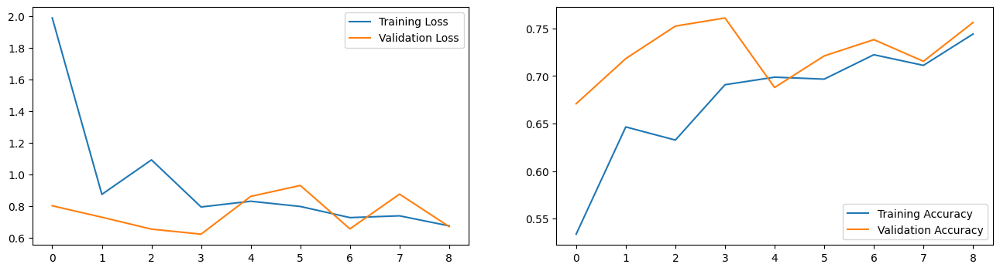

None


In [ ]:
print("Model 6: Data Augmentation", "\n")
print(plot_history(model_6_history))

## Experiment 7: VGG-16 Model

In [ ]:
# Load VGG-16 base model
tf.keras.backend.clear_session()
base_model = tf.keras.applications.VGG16(
    weights='imagenet',
    include_top=False,
    input_shape=(IMG_SIZE, IMG_SIZE, 3)
)
# Freeze base model
base_model.trainable = False

# Build model
inputs = tf.keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
x = base_model(inputs, training=False)
x = layers.Flatten()(x)
x = layers.Dense(512, activation='relu')(x)
outputs = layers.Dense(4, activation='softmax')(x)

model_7 = tf.keras.Model(inputs, outputs)
model_7.summary()

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ vgg16 (Functional)                   │ (None, 7, 7, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 512)                 │      12,845,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 4)                   │           2,052 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 27,562,308 (105.14 MB)

 Trainable params: 12,847,620 (49.01 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [ ]:
# Complile the Model

model_7.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

# Train the model

start_time_7 = time.time()

# Change save_weights_only to True
model_7_history = model_7.fit(x_train_norm
                    ,y_train_split
                    ,epochs=5
                    ,batch_size=64
                    ,validation_data=(x_valid_norm, y_valid_split)
                    ,callbacks=[
                     tf.keras.callbacks.ModelCheckpoint("CNN_model.E7.keras",save_best_only=True,save_weights_only=False)
                    ])

end_time_7 = time.time()

Epoch 1/5
77/77 ━━━━━━━━━━━━━━━━━━━━ 23s 201ms/step - accuracy: 0.6391 - loss: 3.0764 - val_accuracy: 0.8899 - val_loss: 0.2792
Epoch 2/5
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 54ms/step - accuracy: 0.9236 - loss: 0.2110 - val_accuracy: 0.9383 - val_loss: 0.1741
Epoch 3/5
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 54ms/step - accuracy: 0.9670 - loss: 0.0996 - val_accuracy: 0.9355 - val_loss: 0.1672
Epoch 4/5
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 54ms/step - accuracy: 0.9754 - loss: 0.0719 - val_accuracy: 0.9535 - val_loss: 0.1203
Epoch 5/5
77/77 ━━━━━━━━━━━━━━━━━━━━ 3s 42ms/step - accuracy: 0.9884 - loss: 0.0447 - val_accuracy: 0.9526 - val_loss: 0.1214


In [ ]:
# Get Time
runtime_7 = end_time_7 - start_time_7
print("Runtime: {:.2f} seconds".format(runtime_7))

epochs_7 = len(model_7_history.history['accuracy'])
print(f"Model 7 had {epochs_7} epochs")

Runtime: 42.90 seconds
Model 7 had 5 epochs


In [ ]:
# Test Model
test_results_7 = model_7.evaluate(x_test_norm, y_test, verbose=0)[1]
print("Test accuracy: {:.4f}%".format(test_results_7))

Test accuracy: 0.9564%


In [ ]:
# Get Predictions
predictions_model7 = np.argmax(model_7.predict(x_test_norm), axis=1)
print("Shape of predictions model 7:", predictions_model7.shape)

33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step
Shape of predictions model 7: (1054,)


Model 7: VGG-16 Base Model 



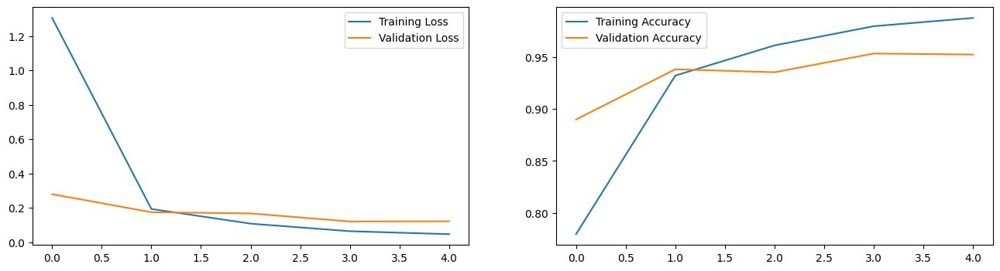

None


In [ ]:
print("Model 7: VGG-16 Base Model", "\n")
print(plot_history(model_7_history))

Model 7: Confusion Matrix VGG-16 Model 

None


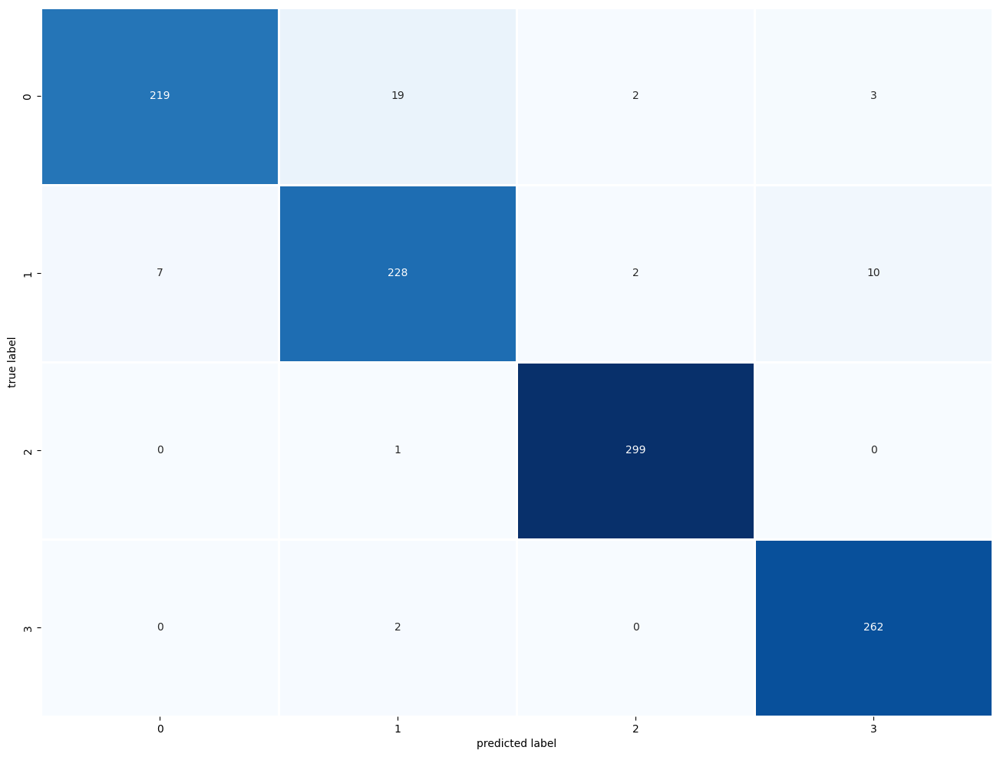

In [ ]:
print("Model 7: Confusion Matrix VGG-16 Model", "\n")
print(plot_confusion_matrix(y_test, predictions_model7))

## Experiment 8: VGG-16 Add Complexity and Regularization

In [ ]:
# Load VGG-16 base model
tf.keras.backend.clear_session()
base_model = tf.keras.applications.VGG16(
    weights='imagenet',
    include_top=False,
    input_shape=(IMG_SIZE, IMG_SIZE, 3)
)
# Freeze base model
base_model.trainable = False

# Build model
inputs = tf.keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
x = base_model(inputs, training=False)
x = layers.Flatten()(x)
x = layers.Dense(512, activation='relu', kernel_regularizer=l2(0.001))(x)
x = layers.Dropout(0.2)(x)
x = layers.Dense(256, activation='relu', kernel_regularizer=l2(0.001))(x)
x = layers.Dropout(0.2)(x)
x = layers.Dense(128, activation='relu', kernel_regularizer=l2(0.001))(x)
x = layers.Dropout(0.2)(x)
outputs = layers.Dense(4, activation='softmax')(x)

model_8 = tf.keras.Model(inputs, outputs)
model_8.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ vgg16 (Functional)                   │ (None, 7, 7, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 512)                 │      12,845,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 4)                   │             516 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 27,724,996 (105.76 MB)

 Trainable params: 13,010,308 (49.63 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [ ]:
# Compile the Model

model_8.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

# Train the model

start_time_8 = time.time()

model_8_history = model_8.fit(x_train_norm
                    ,y_train_split
                    ,epochs=25
                    ,batch_size=64
                    ,validation_data=(x_valid_norm, y_valid_split)
                    ,callbacks=[
                     tf.keras.callbacks.ModelCheckpoint("CNN_model.E8.keras",save_best_only=True,save_weights_only=False),
                     tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
                    ])

end_time_8 = time.time()

Epoch 1/25
154/154 ━━━━━━━━━━━━━━━━━━━━ 23s 121ms/step - accuracy: 0.6063 - loss: 2.1543 - val_accuracy: 0.8624 - val_loss: 0.8984
Epoch 2/25
154/154 ━━━━━━━━━━━━━━━━━━━━ 4s 23ms/step - accuracy: 0.8459 - loss: 0.8778 - val_accuracy: 0.8311 - val_loss: 0.9357
Epoch 3/25
154/154 ━━━━━━━━━━━━━━━━━━━━ 5s 29ms/step - accuracy: 0.8642 - loss: 0.7448 - val_accuracy: 0.8909 - val_loss: 0.6716
Epoch 4/25
154/154 ━━━━━━━━━━━━━━━━━━━━ 5s 29ms/step - accuracy: 0.8668 - loss: 0.6745 - val_accuracy: 0.9108 - val_loss: 0.5748
Epoch 5/25
154/154 ━━━━━━━━━━━━━━━━━━━━ 4s 23ms/step - accuracy: 0.9011 - loss: 0.5613 - val_accuracy: 0.8880 - val_loss: 0.5840
Epoch 6/25
154/154 ━━━━━━━━━━━━━━━━━━━━ 5s 29ms/step - accuracy: 0.8923 - loss: 0.5541 - val_accuracy: 0.9023 - val_loss: 0.5108
Epoch 7/25
154/154 ━━━━━━━━━━━━━━━━━━━━ 5s 29ms/step - accuracy: 0.8941 - loss: 0.5071 - val_accuracy: 0.9298 - val_loss: 0.4488
Epoch 8/25
154/154 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - accuracy: 0.9144 - loss: 0.4658 - val_ac

In [ ]:
# get Time
runtime_8 = end_time_8 - start_time_8
print("Runtime: {:.2f} seconds".format(runtime_8))

epochs_8 = len(model_8_history.history['accuracy'])
print(f"Model 8 had {epochs_8} epochs")

Runtime: 126.56 seconds
Model 8 had 25 epochs


In [ ]:
# Test Model
test_results_8 = model_8.evaluate(x_test_norm, y_test, verbose=0)[1]
print("Test accuracy: {:.4f}%".format(test_results_8))

Test accuracy: 0.9497%


In [ ]:
# Get Predictions
predictions_model8 = np.argmax(model_8.predict(x_test_norm), axis=1)
print("Shape of predictions model 8:", predictions_model8.shape)

33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 51ms/step
Shape of predictions model 8: (1054,)


Model 8: VGG-16 Added Complexity 



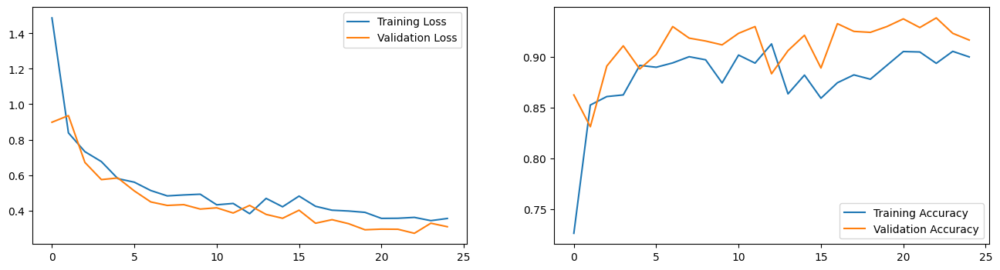

None


In [ ]:
print("Model 8: VGG-16 Added Complexity", "\n")
print(plot_history(model_8_history))

## Experiment 9: VGG-16 Refine

In [ ]:
# Load VGG-16 base model
tf.keras.backend.clear_session()
base_model = tf.keras.applications.VGG16(
    weights='imagenet',
    include_top=False,
    input_shape=(IMG_SIZE, IMG_SIZE, 3)
)
# Freeze base model
base_model.trainable = False

# Build model
inputs = tf.keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
x = base_model(inputs, training=False)
x = layers.Flatten()(x)
x = layers.Dense(512, activation='relu', kernel_regularizer=l2(0.001))(x)
x = layers.Dense(256, activation='relu', kernel_regularizer=l2(0.001))(x)
x = layers.Dense(128, activation='relu', kernel_regularizer=l2(0.001))(x)

outputs = layers.Dense(4, activation='softmax')(x)

model_9 = tf.keras.Model(inputs, outputs)
model_9.summary()

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ vgg16 (Functional)                   │ (None, 7, 7, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 512)                 │      12,845,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 4)                   │             516 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 27,724,996 (105.76 MB)

 Trainable params: 13,010,308 (49.63 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [ ]:
# Compile the Model

optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)
model_9.compile(optimizer=optimizer,
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

# Train the model

start_time_9 = time.time()

# Change save_weights_only to True
model_9_history = model_9.fit(x_train_norm
                    ,y_train_split
                    ,epochs=50
                    ,batch_size=64
                    ,validation_data=(x_valid_norm, y_valid_split)
                    ,callbacks=[
                     tf.keras.callbacks.ModelCheckpoint("CNN_model.E9.keras",save_best_only=True,save_weights_only=False),
                     tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
                    ])

end_time_9 = time.time()

Epoch 1/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 37s 314ms/step - accuracy: 0.6973 - loss: 2.1248 - val_accuracy: 0.8909 - val_loss: 1.3078
Epoch 2/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 55ms/step - accuracy: 0.9139 - loss: 1.2082 - val_accuracy: 0.9118 - val_loss: 1.0644
Epoch 3/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 55ms/step - accuracy: 0.9392 - loss: 0.9714 - val_accuracy: 0.9194 - val_loss: 0.9322
Epoch 4/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 55ms/step - accuracy: 0.9642 - loss: 0.8160 - val_accuracy: 0.9317 - val_loss: 0.8354
Epoch 5/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 57ms/step - accuracy: 0.9713 - loss: 0.7261 - val_accuracy: 0.9497 - val_loss: 0.7408
Epoch 6/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 54ms/step - accuracy: 0.9832 - loss: 0.6507 - val_accuracy: 0.9450 - val_loss: 0.6957
Epoch 7/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 55ms/step - accuracy: 0.9816 - loss: 0.6035 - val_accuracy: 0.9393 - val_loss: 0.6599
Epoch 8/50
77/77 ━━━━━━━━━━━━━━━━━━━━ 4s 55ms/step - accuracy: 0.9929 - loss: 0.5403 - val_accuracy: 0.9592 -

In [ ]:
# Get Time
runtime_9 = end_time_9 - start_time_9
print("Runtime: {:.2f} seconds".format(runtime_9))

epochs_9 = len(model_9_history.history['accuracy'])
print(f"Model 9 had {epochs_9} epochs")

Runtime: 93.66 seconds
Model 9 had 20 epochs


In [ ]:
# Test Model
test_results_9 = model_9.evaluate(x_test_norm, y_test, verbose=0)[1]
print("Test accuracy: {:.4f}%".format(test_results_9))

Test accuracy: 0.9649%


In [ ]:
# Get Predictions
predictions_model9 = np.argmax(model_9.predict(x_test_norm), axis=1)
print("Shape of predictions model 9:", predictions_model9.shape)

33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 50ms/step
Shape of predictions model 9: (1054,)


Model 9: VGG-16 Refine 



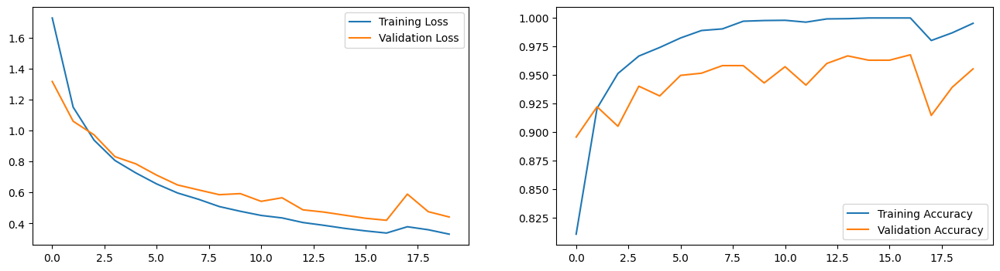

None


In [ ]:
print("Model 9: VGG-16 Refine", "\n")
print(plot_history(model_9_history))

Model 9: Confusion Matrix 

None


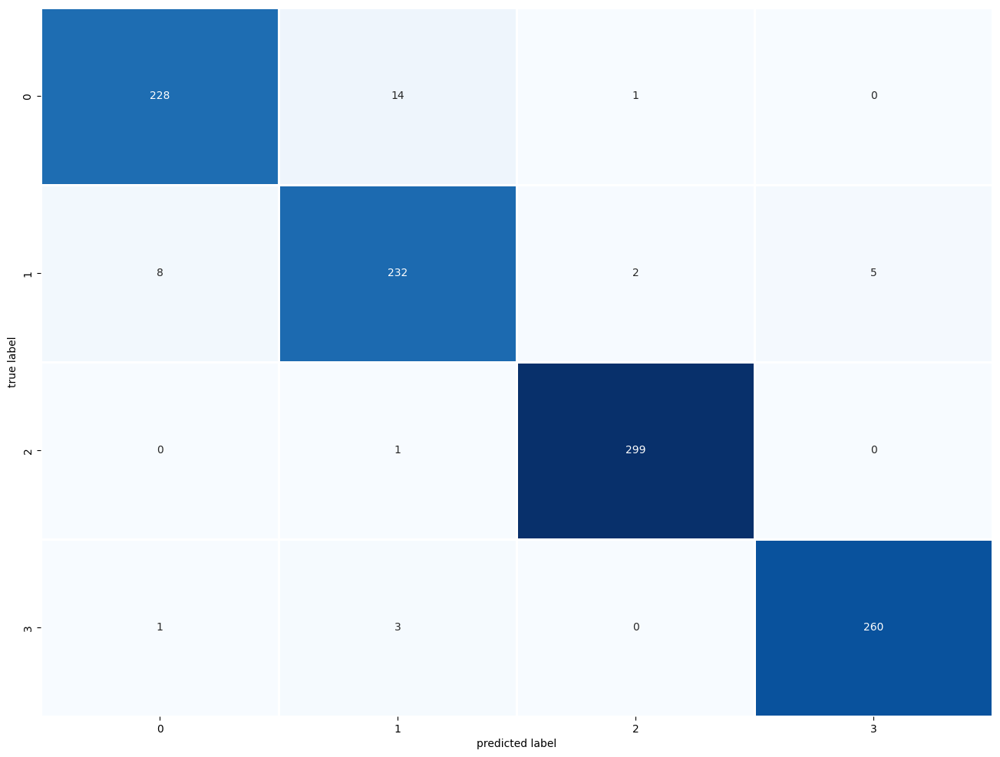

In [ ]:
print("Model 9: Confusion Matrix", "\n")
print(plot_confusion_matrix(y_test, predictions_model9))

In [ ]:
print("Model 9: Validation Report", "\n")
print(print_validation_report(y_test, predictions_model9))

Model 9: Validation Report 

Classification Report
              precision    recall  f1-score   support

           0       0.96      0.94      0.95       243
           1       0.93      0.94      0.93       247
           2       0.99      1.00      0.99       300
           3       0.98      0.98      0.98       264

    accuracy                           0.97      1054
   macro avg       0.97      0.96      0.96      1054
weighted avg       0.97      0.97      0.97      1054

Accuracy Score: 0.9667931688804554
Root Mean Square Error: 0.2577084830561252
None


### Extract Activation Values and Build Feature Map

In [ ]:
layer_outputs = [layer.output for layer in base_model.layers[:16]]
layer_names = [layer.name for layer in base_model.layers[:16]]
activation_model = Model(inputs=base_model.input, outputs=layer_outputs)

layer_outputs = [layer.output for layer in base_model.layers if 'pool' in layer.name][0:16]  # Capture pooling layers and conv layers
layer_names = [layer.name for layer in base_model.layers if 'pool' in layer.name][0:16]  # Layer names, adjusted for pooling

activation_model = Model(inputs=base_model.input, outputs=layer_outputs)

# Preprocess input image
img_tensor = tf.image.resize(img, (IMG_SIZE, IMG_SIZE))
img_tensor = tf.keras.applications.vgg16.preprocess_input(img_tensor)  # VGG-16 preprocessing
img_tensor = tf.expand_dims(img_tensor, axis=0)  # batch dimension

# Predict activations
activations_9 = activation_model.predict(img_tensor)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 678ms/step


<ipython-input-78-c165511767dc>:36: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
<ipython-input-78-c165511767dc>:26: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


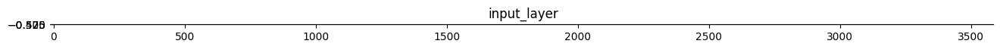

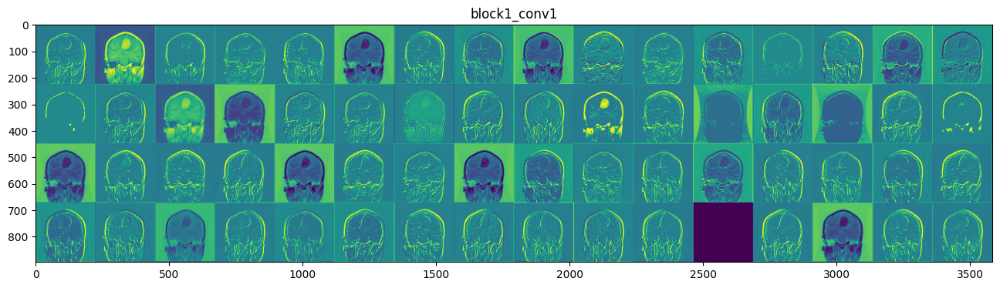

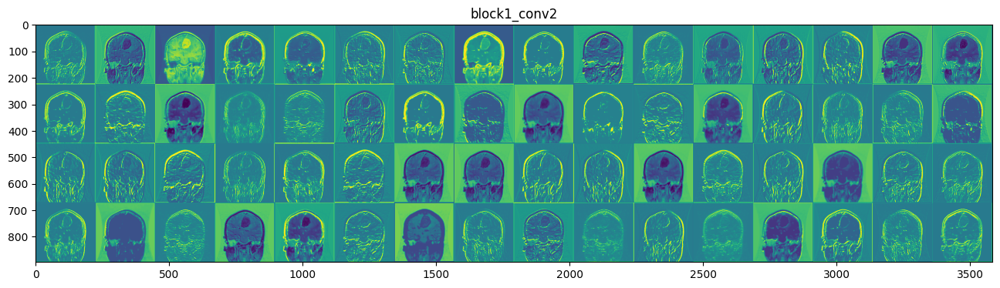

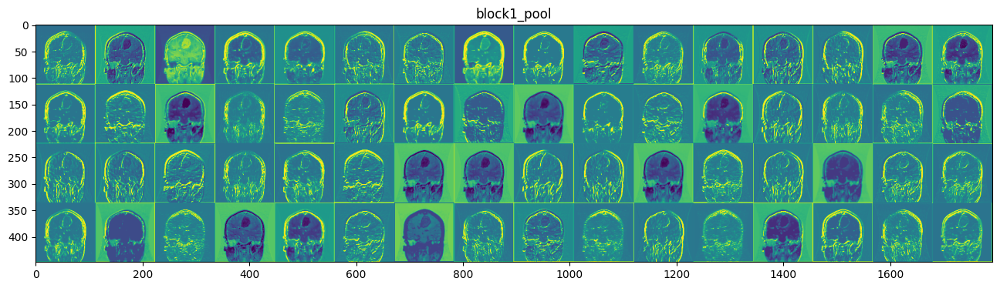

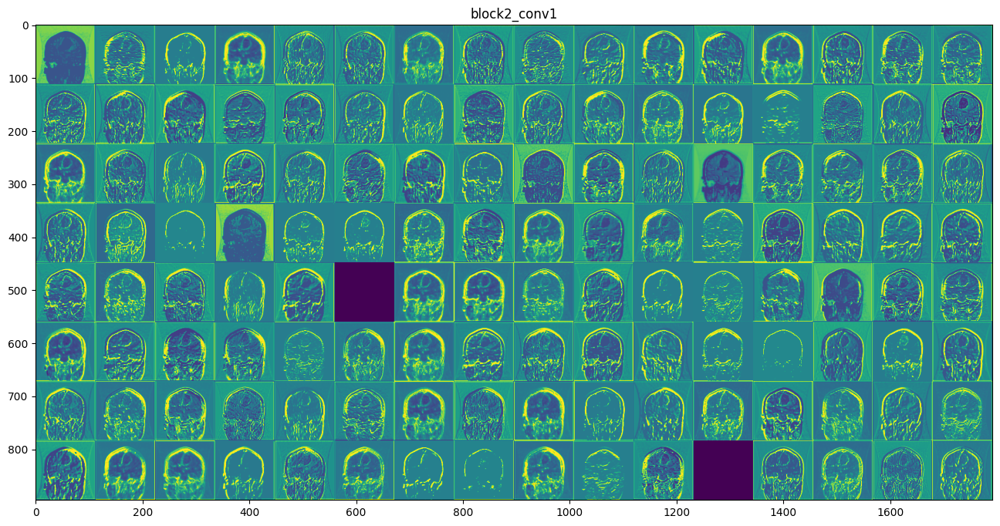

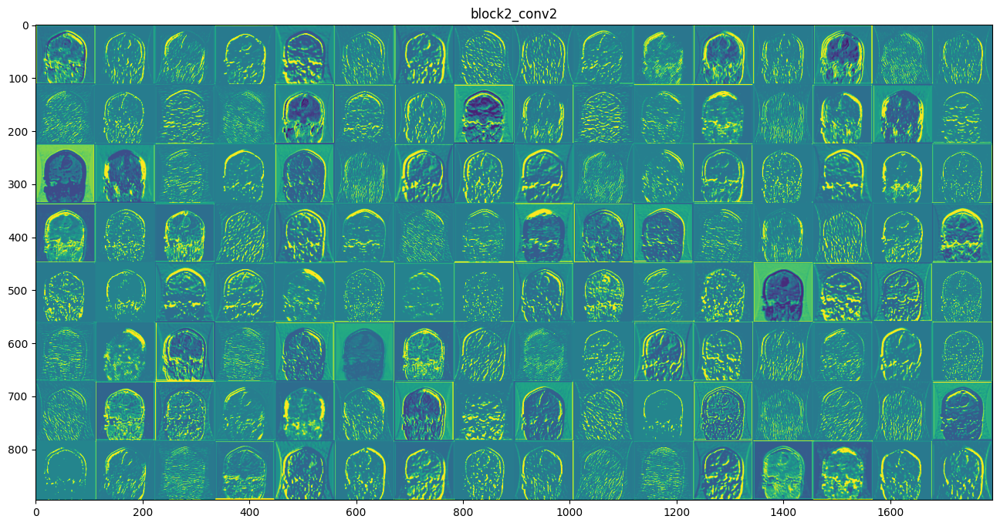

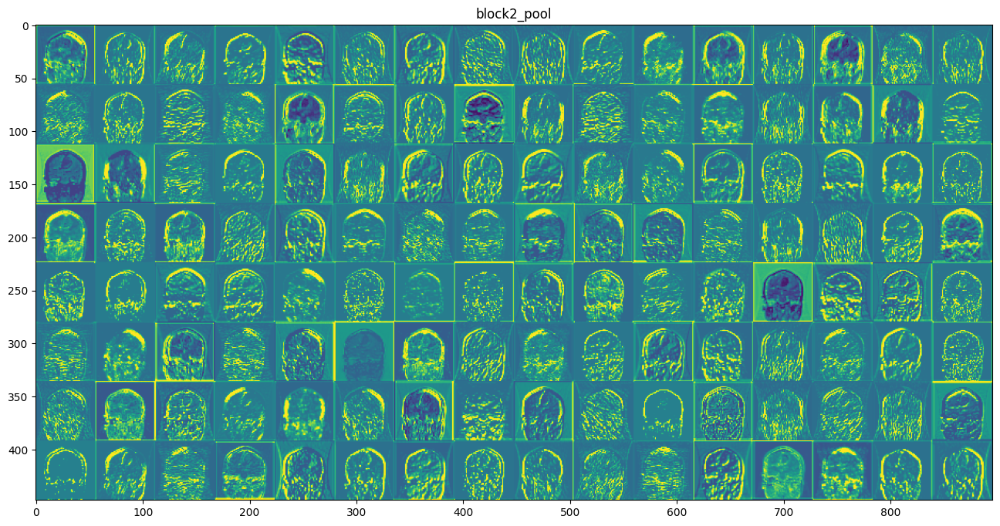

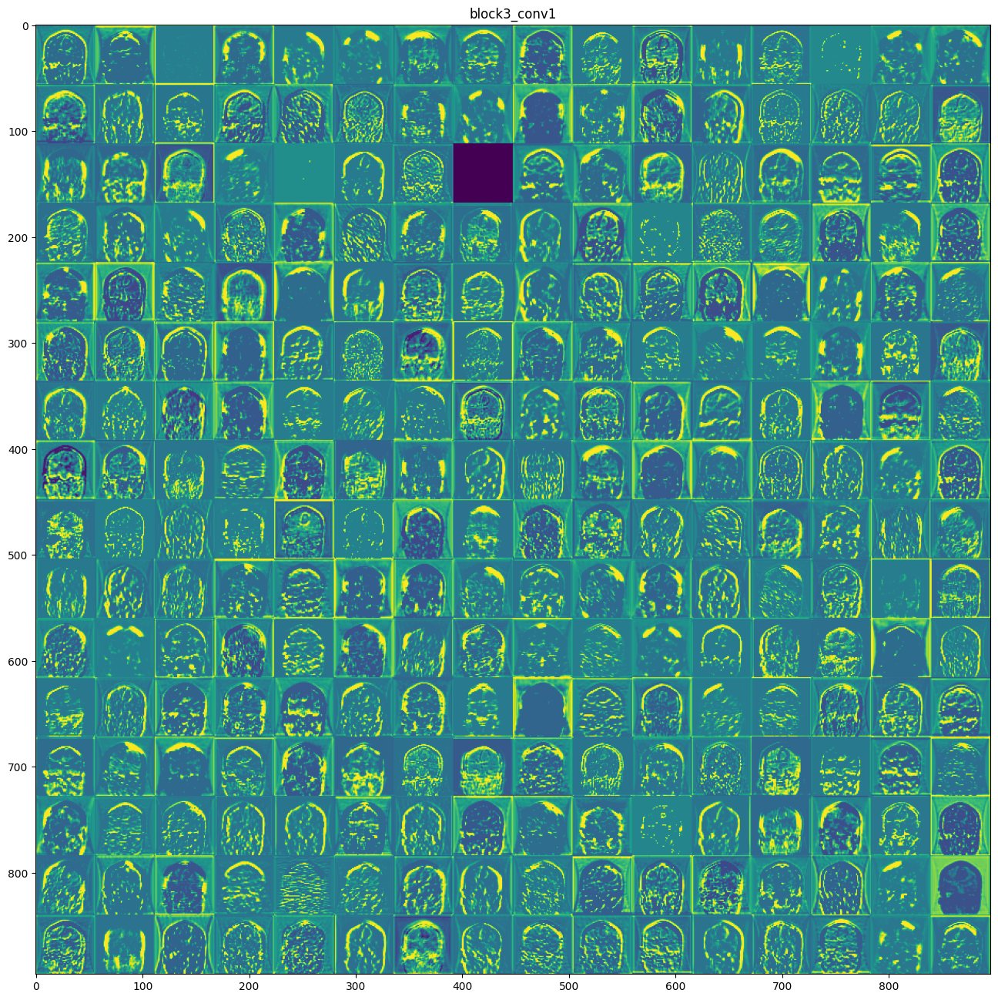

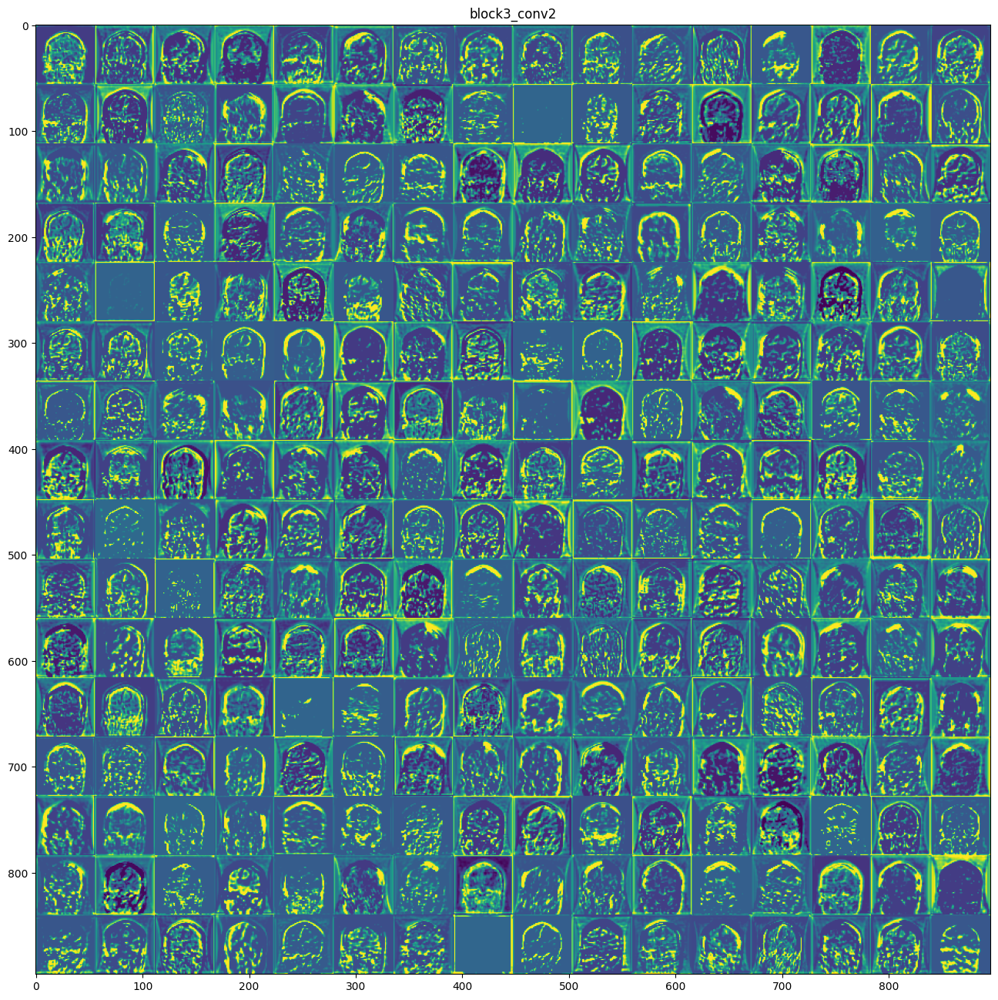

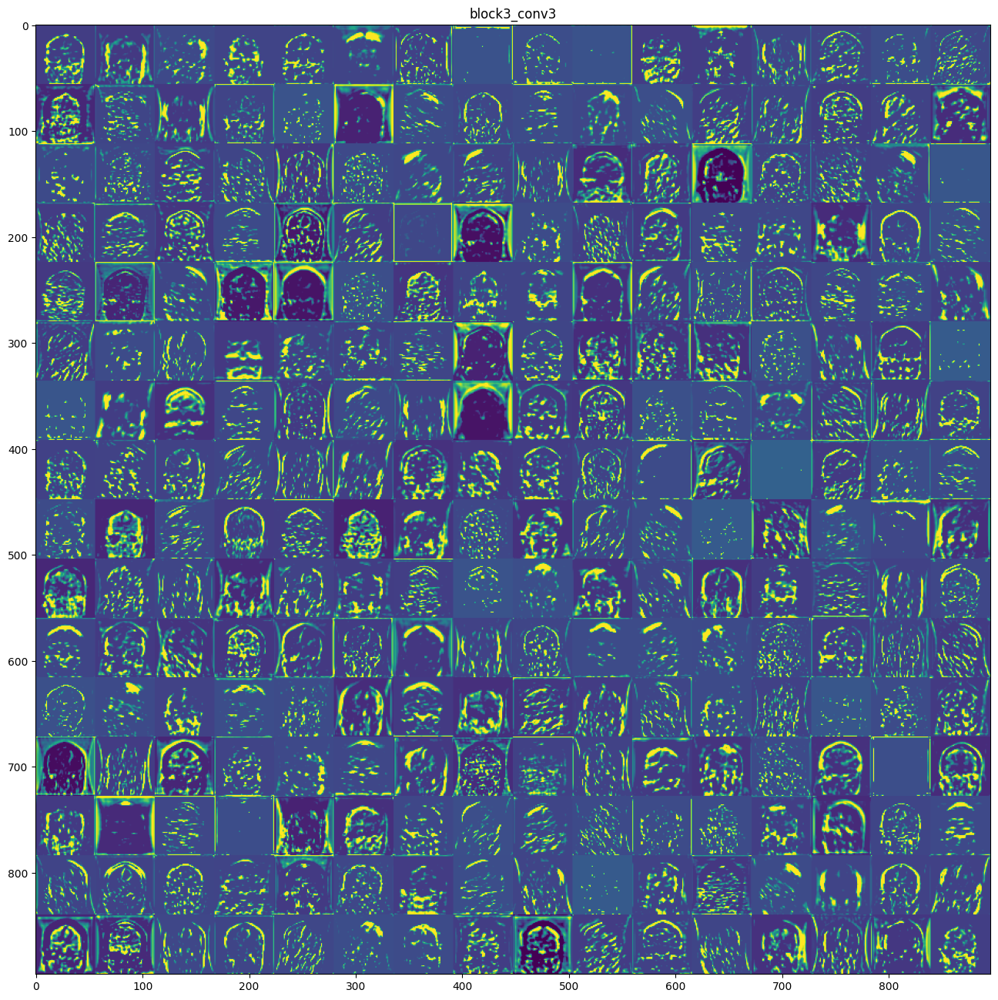

In [ ]:
images_per_row = 16

# display the feature maps
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    # tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

plt.show();

In [ ]:
layer_outputs = [layer.output for layer in base_model.layers if 'pool' in layer.name][0:20]  # Capture pooling layers and conv layers
layer_names = [layer.name for layer in base_model.layers if 'pool' in layer.name][0:20]  # Layer names, adjusted for pooling

activation_model = Model(inputs=base_model.input, outputs=layer_outputs)

# Preprocess input image
img_tensor = tf.image.resize(img, (IMG_SIZE, IMG_SIZE))
img_tensor = tf.keras.applications.vgg16.preprocess_input(img_tensor)  # VGG-16 preprocessing
img_tensor = tf.expand_dims(img_tensor, axis=0)  # batch dimension

# Predict activations
activations_9 = activation_model.predict(img_tensor)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


<ipython-input-80-c165511767dc>:36: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
<ipython-input-80-c165511767dc>:26: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


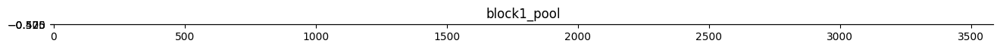

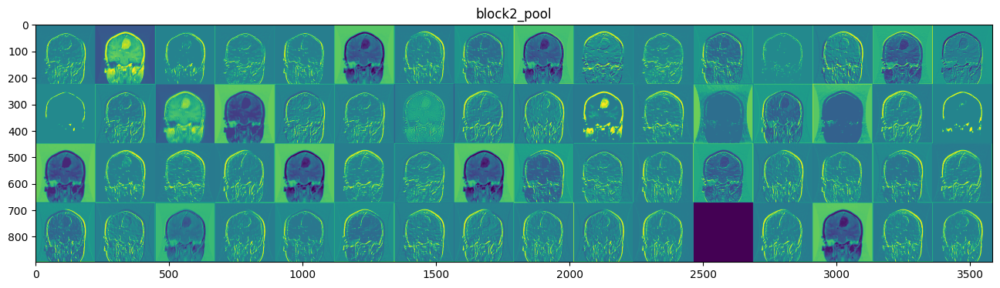

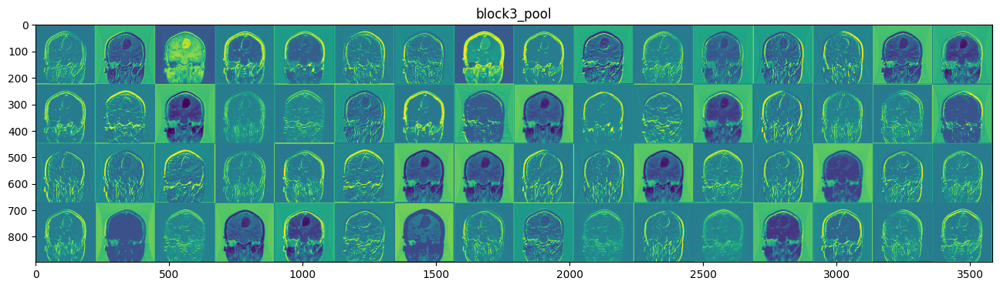

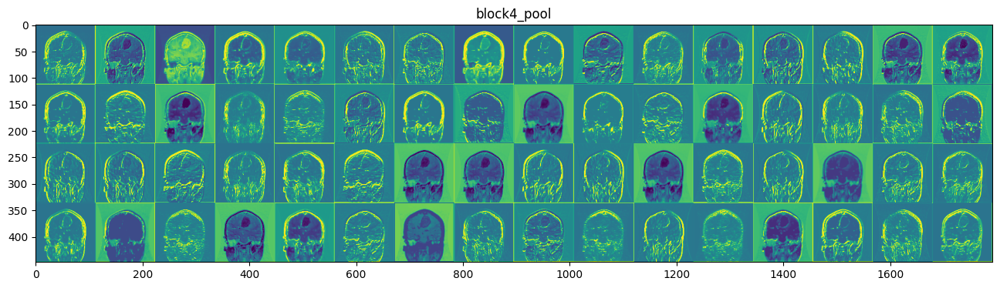

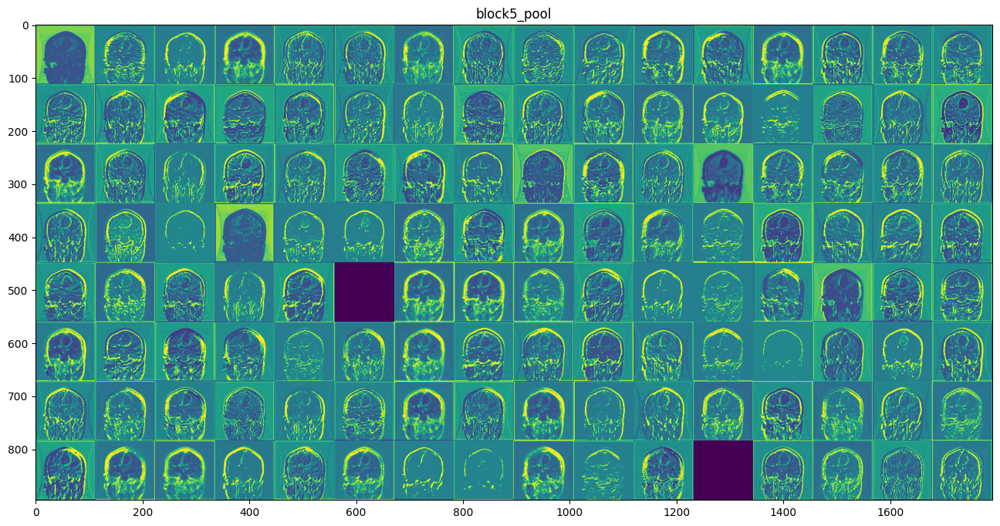

In [ ]:
images_per_row = 16

# display the feature maps
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    # tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

plt.show();

## Experiment 10: VGG-16 Add Data Augmentation

In [ ]:
tf.keras.backend.clear_session()

# Define data augmentation
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip("vertical_and_horizontal"),
    layers.RandomRotation(0.10),
    layers.RandomContrast(0.10)
])

base_model = tf.keras.applications.VGG16(
    weights='imagenet',
    include_top=False,
    input_shape=(IMG_SIZE, IMG_SIZE, 3)
)
# Freeze base model
base_model.trainable = False

# Build model
inputs = tf.keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
x = data_augmentation(inputs)  # Add data augmentation here
x = base_model(x, training=False)
x = layers.Flatten()(x)
x = layers.Dense(512, activation='relu', kernel_regularizer=l2(0.001))(x)
x = layers.Dense(256, activation='relu', kernel_regularizer=l2(0.001))(x)
x = layers.Dense(128, activation='relu', kernel_regularizer=l2(0.001))(x)


outputs = layers.Dense(4, activation='softmax')(x)

model_10 = tf.keras.Model(inputs, outputs)
model_10.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ sequential (Sequential)              │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ vgg16 (Functional)                   │ (None, 7, 7, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 512)                 │      12,845,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 4)                   │             516 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 27,724,996 (105.76 MB)

 Trainable params: 13,010,308 (49.63 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [ ]:
# Compile the Model

optimizer = tf.keras.optimizers.Adam(learning_rate=0.00001)
model_10.compile(optimizer=optimizer,
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

# Train the model

start_time_10 = time.time()

model_10_history = model_10.fit(x_train_norm
                    ,y_train_split
                    ,epochs=100
                    ,batch_size=64
                    ,validation_data=(x_valid_norm, y_valid_split)
                    ,callbacks=[
                     tf.keras.callbacks.ModelCheckpoint("CNN_model.E10.keras",save_best_only=True,save_weights_only=False),
                     tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
                    ])

end_time_10 = time.time()

Epoch 1/100
77/77 ━━━━━━━━━━━━━━━━━━━━ 18s 197ms/step - accuracy: 0.6059 - loss: 2.6011 - val_accuracy: 0.8273 - val_loss: 2.0532
Epoch 2/100
77/77 ━━━━━━━━━━━━━━━━━━━━ 5s 68ms/step - accuracy: 0.8248 - loss: 1.9919 - val_accuracy: 0.8501 - val_loss: 1.8445
Epoch 3/100
77/77 ━━━━━━━━━━━━━━━━━━━━ 5s 68ms/step - accuracy: 0.8514 - loss: 1.8263 - val_accuracy: 0.8643 - val_loss: 1.7355
Epoch 4/100
77/77 ━━━━━━━━━━━━━━━━━━━━ 5s 68ms/step - accuracy: 0.8842 - loss: 1.6956 - val_accuracy: 0.8871 - val_loss: 1.6518
Epoch 5/100
77/77 ━━━━━━━━━━━━━━━━━━━━ 5s 68ms/step - accuracy: 0.9019 - loss: 1.6143 - val_accuracy: 0.8890 - val_loss: 1.6097
Epoch 6/100
77/77 ━━━━━━━━━━━━━━━━━━━━ 5s 69ms/step - accuracy: 0.9066 - loss: 1.5514 - val_accuracy: 0.8975 - val_loss: 1.5346
Epoch 7/100
77/77 ━━━━━━━━━━━━━━━━━━━━ 5s 68ms/step - accuracy: 0.9072 - loss: 1.4975 - val_accuracy: 0.9023 - val_loss: 1.4972
Epoch 8/100
77/77 ━━━━━━━━━━━━━━━━━━━━ 5s 67ms/step - accuracy: 0.9243 - loss: 1.4380 - val_accuracy: 

In [ ]:
# Get Time
runtime_10 = end_time_10 - start_time_10
print("Runtime: {:.2f} seconds".format(runtime_10))

epochs_10 = len(model_10_history.history['accuracy'])
print(f"Model 10 had {epochs_10} epochs")

Runtime: 513.80 seconds
Model 10 had 100 epochs


In [ ]:
# Test Model
test_results_10 = model_10.evaluate(x_test_norm, y_test, verbose=0)[1]
print("Test accuracy: {:.4f}%".format(test_results_10))

Test accuracy: 0.9630%


In [ ]:
# Get Predictions
predictions_model10 = np.argmax(model_10.predict(x_test_norm), axis=1)
print("Shape of predictions model 10:", predictions_model10.shape)

33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
Shape of predictions model 10: (1054,)


Model 10: VGG-16 Data Augmentation 



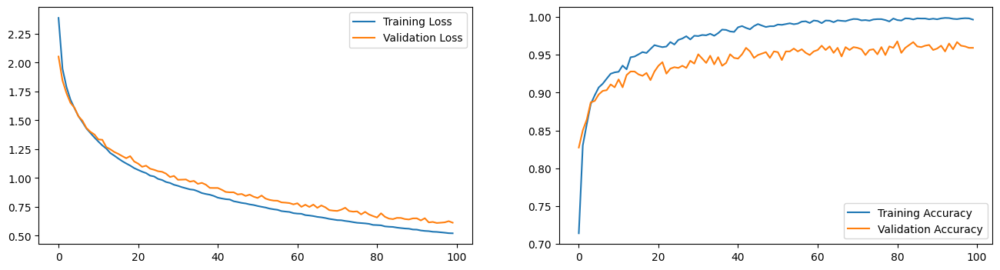

None


In [ ]:
print("Model 10: VGG-16 Data Augmentation", "\n")
print(plot_history(model_10_history))

## Experiment 9 - tSNE Plot

In [ ]:
# Get activations from a specific layer
feature_extractor = Model(
    inputs=model_9.input,
    outputs=model_9.get_layer('dense_1').output
)

# Get features from validation set
features = feature_extractor.predict(x_valid_norm[:4000])

# Flatten if needed
if len(features.shape) > 2:
    features = features.reshape(features.shape[0], -1)

33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 38ms/step


In [ ]:
# Perform t-SNE
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(features)

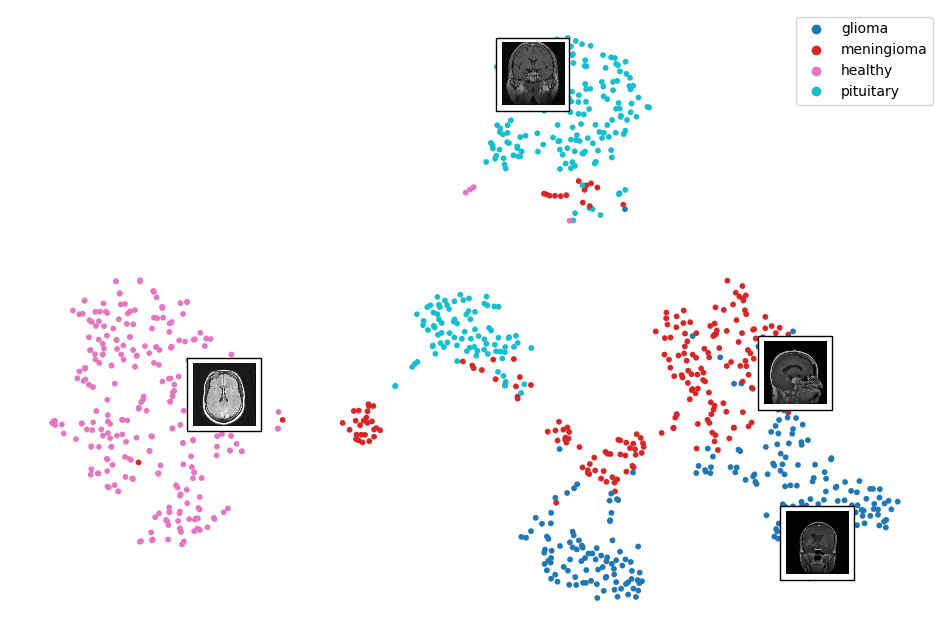

In [ ]:
cmap = plt.cm.tab10
plt.figure(figsize=(12,8))
scatter = plt.scatter(tsne_results[:,0], tsne_results[:,1], c=y_valid_split[:2000], s=10, cmap=cmap)
plt.legend(handles=scatter.legend_elements()[0], labels=CATEGORIES)

classes = {}

image_positions = np.array([[1., 1.]])
for index, (position, label) in enumerate(zip(tsne_results, y_valid_split[:2000])):
    if label in classes:
        continue

    dist = np.sum((position - image_positions) ** 2, axis=1)
    if np.min(dist) > 0.02:
        image_positions = np.r_[image_positions, [position]]
        # Create smaller image using zoom parameter
        imagebox = mpl.offsetbox.AnnotationBbox(
            mpl.offsetbox.OffsetImage(x_valid_norm[index], zoom=0.2),
            position, bboxprops={"lw": 1})
        plt.gca().add_artist(imagebox)
        classes[label] = True

        if len(classes) == len(CATEGORIES):
            break

plt.axis("off")
plt.show()

## Visualize the Healthy Misclassifed

In [ ]:
# Get predictions
y_pred = model_9.predict(x_valid_norm)
y_pred_classes = np.argmax(y_pred, axis=1)
y_true_classes = y_valid_split

# Find misclassified indices
misclassified_indices = []
for idx, (true, pred) in enumerate(zip(y_true_classes, y_pred_classes)):
    if pred == 2 and true != 2:  # Predicted healthy when actually tumor
        misclassified_indices.append(idx)


33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step


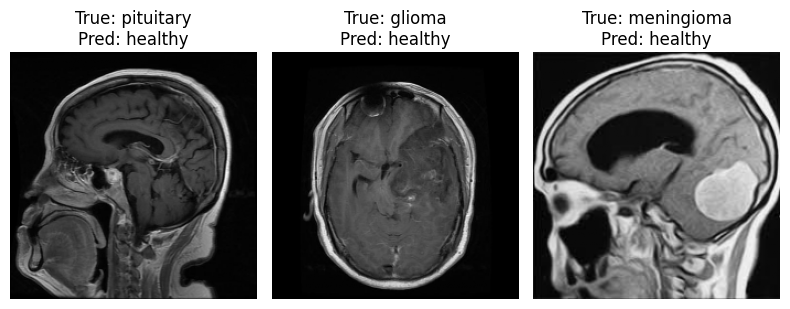

In [ ]:
# Plot misclassified examples
fig, axes = plt.subplots(1, 3, figsize=(8, 8))
axes = axes.ravel()

for idx, ax in enumerate(axes):
    if idx < len(misclassified_indices):
        image_idx = misclassified_indices[idx]
        ax.imshow(x_valid_norm[image_idx])
        ax.set_title(f'True: {CATEGORIES[y_true_classes[image_idx]]}\nPred: {CATEGORIES[y_pred_classes[image_idx]]}')
        ax.axis('off')

plt.tight_layout()
plt.show()

## Summary of Experiments

In [ ]:
experiments = ['Model 1: Baseline CNN', 'Model 2: CNN - Added Complexity', 'Model 3: CNN - Refine', 'Model 4: Baseline ResNet50', 'Model 5: ResNet50 - Added Complexity', 'Model 6: ResNet50 - Data Augment', 'Model 7: Baseline VGG-16', 'Model 8: VGG-16 Added Complexity', 'Model 9: VGG-16 - Refine', 'Model 10: VGG-16 Data Augment']
losses = [ model_1_history.history['accuracy'][-1], model_2_history.history['loss'][-1], model_3_history.history['loss'][-1], model_4_history.history['loss'][-1], model_5_history.history['loss'][-1], model_6_history.history['loss'][-1], model_7_history.history['loss'][-1], model_8_history.history['loss'][-1], model_9_history.history['loss'][-1], model_10_history.history['loss'][-1]]
accs = [model_1_history.history['accuracy'][-1], model_2_history.history['accuracy'][-1], model_3_history.history['accuracy'][-1], model_4_history.history['accuracy'][-1], model_5_history.history['accuracy'][-1], model_6_history.history['accuracy'][-1], model_7_history.history['accuracy'][-1], model_8_history.history['accuracy'][-1], model_9_history.history['accuracy'][-1], model_10_history.history['accuracy'][-1]]
val_losses = [model_1_history.history['val_loss'][-1], model_2_history.history['val_loss'][-1], model_3_history.history['val_loss'][-1], model_4_history.history['val_loss'][-1], model_5_history.history['val_loss'][-1], model_6_history.history['val_loss'][-1], model_7_history.history['val_loss'][-1], model_8_history.history['val_loss'][-1], model_9_history.history['val_loss'][-1], model_10_history.history['val_loss'][-1]]
val_accs = [model_1_history.history['val_accuracy'][-1], model_2_history.history['val_accuracy'][-1], model_3_history.history['val_accuracy'][-1], model_4_history.history['val_accuracy'][-1], model_5_history.history['val_accuracy'][-1], model_6_history.history['val_accuracy'][-1], model_7_history.history['val_accuracy'][-1], model_8_history.history['val_accuracy'][-1], model_9_history.history['val_accuracy'][-1], model_10_history.history['val_accuracy'][-1]]
test_accs = [test_results_1, test_results_2, test_results_3, test_results_4, test_results_5, test_results_6, test_results_7, test_results_8, test_results_9, test_results_10]
epochs = [epochs_1, epochs_2, epochs_3, epochs_4, epochs_5, epochs_6, epochs_7, epochs_8, epochs_9, epochs_10]
training_times = [runtime_1, runtime_2, runtime_3, runtime_4, runtime_5, runtime_6, runtime_7, runtime_8, runtime_9, runtime_10]

In [ ]:
# Create Dataframe for summary
models_summary = pd.DataFrame({
    'Experiment': experiments,
    'Loss': losses,
    'Accuracy': accs,
    'Val Loss': val_losses,
    'Val Accuracy': val_accs,
    'Test Accuracy': test_accs,
    'Epochs': epochs,
    'Training Time': training_times
})

models_summary.set_index('Experiment', inplace=True)
models_summary = models_summary.round(3)

In [ ]:
print(models_summary.to_string(index=True, header=True))

                                       Loss  Accuracy  Val Loss  Val Accuracy  Test Accuracy  Epochs  Training Time
Experiment                                                                                                         
Model 1: Baseline CNN                 1.000     1.000     0.347         0.925          0.945      15         47.028
Model 2: CNN - Added Complexity       0.266     0.981     0.427         0.925          0.935      20         75.855
Model 3: CNN - Refine                 0.249     0.980     0.391         0.944          0.947      22         72.832
Model 4: Baseline ResNet50            0.507     0.787     0.512         0.783          0.780      25        122.009
Model 5: ResNet50 - Added Complexity  0.733     0.733     0.665         0.783          0.757      15         90.118
Model 6: ResNet50 - Data Augment      0.673     0.744     0.668         0.756          0.750       9         57.065
Model 7: Baseline VGG-16              0.047     0.988     0.121         

In [ ]:
cd drive/MyDrive/DS-458/assignment\ 4

/content/drive/MyDrive/DS-458/assignment 4


In [ ]:
from google.colab import files
# notebook file name
!jupyter nbconvert --to html "assignment_04_Remsza.ipynb"
# Download the converted HTML file
files.download('assignment_04_Remsza.html')

[NbConvertApp] Converting notebook assignment_04_Remsza.ipynb to html
[NbConvertApp] WARNING | Alternative text is missing on 28 image(s).
[NbConvertApp] Writing 5207351 bytes to assignment_04_Remsza.html


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>